# Library Import

In [27]:
import os
import torch
import torchvision

import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torchmetrics, mlxtend

from torchvision import transforms, datasets
from torchmetrics import Accuracy, ConfusionMatrix
from torchmetrics import MetricCollection
from torchmetrics.classification import MulticlassAccuracy, MulticlassPrecision, MulticlassRecall, MulticlassF1Score
from torch.utils.data import Dataset, DataLoader
from torch.utils.tensorboard import SummaryWriter
from mlxtend.plotting import plot_confusion_matrix


import random

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from pathlib import Path
from tqdm.auto import tqdm

from helper_functions import train_and_evaluate, save_model, save_history, plot_random_samples_grid, plot_confusion_matrix_range, plot_accuracy_loss, predict_model

In [2]:
# Set up plotting style
plt.style.use('seaborn-v0_8-whitegrid')
sns.set_style("whitegrid")
sns.set_palette("deep")

# Data Loading


In [3]:
data_path = '100-bird-species'

### Data Augmentation

In [4]:
class CustomDataset(Dataset):
    def __init__(self, data_path, transform=None):
        self.data_path = data_path
        self.transform = transform
        self.dataset = datasets.ImageFolder(root=self.data_path, transform=self.transform)
        self.classes = self.dataset.classes

    def __len__(self):
        return len(self.dataset)

    def __getitem__(self, idx):
        images, targets = self.dataset[idx]
        return images, targets

In [5]:
transform = transforms.Compose([
    transforms.RandomHorizontalFlip(),
    transforms.RandomRotation(15, fill=144),
    transforms.ToTensor(),
    transforms.Resize((224, 224)),
])

train_dataset = CustomDataset(f'{data_path}/train', transform)
test_dataset = CustomDataset(f'{data_path}/test', transform)
valid_dataset = CustomDataset(f'{data_path}/valid', transform)

In [6]:
len(train_dataset), len(test_dataset), len(valid_dataset)

(84635, 2625, 2625)

In [7]:
torch.manual_seed(42)
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=32, shuffle=False)
valid_loader = DataLoader(valid_dataset, batch_size=32, shuffle=False)

len(train_loader), len(test_loader), len(valid_loader)

(2645, 83, 83)

In [8]:
a = next(iter(train_loader))
a[0].shape, a[1].shape

(torch.Size([32, 3, 224, 224]), torch.Size([32]))

In [9]:
original_dataset = CustomDataset(f'{data_path}/train')
train_dataset = CustomDataset(f'{data_path}/train', transform)
original_dataset[0], train_dataset[0]

((<PIL.Image.Image image mode=RGB size=224x224>, 0),
 (tensor([[[0.5647, 0.5647, 0.5647,  ..., 0.5647, 0.5647, 0.5647],
           [0.5647, 0.5647, 0.5647,  ..., 0.5647, 0.5647, 0.5647],
           [0.5647, 0.5647, 0.5647,  ..., 0.5647, 0.5647, 0.5647],
           ...,
           [0.5647, 0.5647, 0.5647,  ..., 0.5647, 0.5647, 0.5647],
           [0.5647, 0.5647, 0.5647,  ..., 0.5647, 0.5647, 0.5647],
           [0.5647, 0.5647, 0.5647,  ..., 0.5647, 0.5647, 0.5647]],
  
          [[0.5647, 0.5647, 0.5647,  ..., 0.5647, 0.5647, 0.5647],
           [0.5647, 0.5647, 0.5647,  ..., 0.5647, 0.5647, 0.5647],
           [0.5647, 0.5647, 0.5647,  ..., 0.5647, 0.5647, 0.5647],
           ...,
           [0.5647, 0.5647, 0.5647,  ..., 0.5647, 0.5647, 0.5647],
           [0.5647, 0.5647, 0.5647,  ..., 0.5647, 0.5647, 0.5647],
           [0.5647, 0.5647, 0.5647,  ..., 0.5647, 0.5647, 0.5647]],
  
          [[0.5647, 0.5647, 0.5647,  ..., 0.5647, 0.5647, 0.5647],
           [0.5647, 0.5647, 0.5647, 

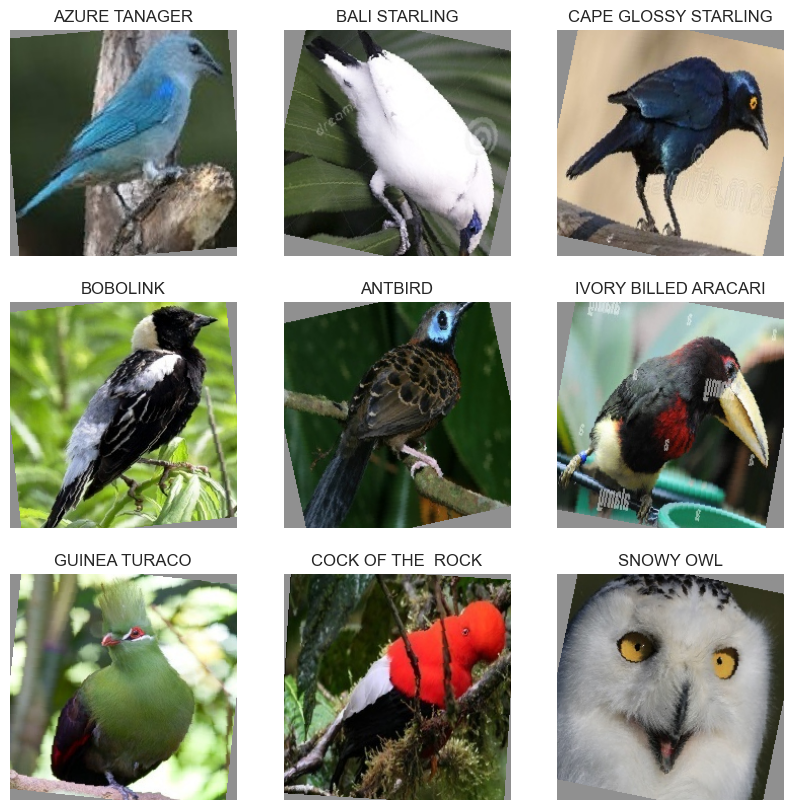

In [10]:
# Random plot some images in the training dataset
class_names = train_dataset.classes

fig, ax = plt.subplots(3, 3, figsize=(10, 10))
for i in range(3):
    for j in range(3):
        idx = np.random.randint(len(train_dataset))
        img, label = train_dataset[idx]
        ax[i, j].imshow(img.permute(1, 2, 0))
        ax[i, j].set_title(class_names[label])
        ax[i, j].axis('off')

# Model Building

### Hyperparameters

In [11]:
### HYPERPARAMETERS
# image
HEIGHT = 224
WIDTH = 224
CHANNELS = 3
CLASSES = len(train_dataset.classes)
LABELS = train_dataset.classes

# training
SEED = 42
DEVICE = "mps" if torch.backends.mps.is_available() else "cuda" if torch.cuda.is_available() else "cpu"
GROWTH_RATE = 16

In [12]:
print(f"Using {DEVICE} device")
print(f"Number of classes: {CLASSES}")
print(f"Class labels: {LABELS[:3]}")
print(f"Device: {DEVICE}")

Using mps device
Number of classes: 525
Class labels: ['ABBOTTS BABBLER', 'ABBOTTS BOOBY', 'ABYSSINIAN GROUND HORNBILL']
Device: mps


In [13]:
# mps only for apple devices with apple silicon, cuda for nvidia gpu, else cpu
DEVICE

'mps'

## EfficientNet

### Class and Instance

In [14]:
class MBConv(nn.Module):
    def __init__(self, in_channels, out_channels, expand_ratio, stride):
        super(MBConv, self).__init__()
        self.use_residual = in_channels == out_channels and stride == 1
        hidden_dim = in_channels * expand_ratio
        
        self.expand = nn.Sequential(
            nn.Conv2d(in_channels, hidden_dim, 1, bias=False),
            nn.BatchNorm2d(hidden_dim),
            nn.SiLU()
        ) if expand_ratio != 1 else nn.Identity()
        
        self.depthwise = nn.Sequential(
            nn.Conv2d(hidden_dim, hidden_dim, 3, stride, 1, groups=hidden_dim, bias=False),
            nn.BatchNorm2d(hidden_dim),
            nn.SiLU()
        )
        
        self.project = nn.Sequential(
            nn.Conv2d(hidden_dim, out_channels, 1, bias=False),
            nn.BatchNorm2d(out_channels)
        )

    def forward(self, x):
        residual = x
        x = self.expand(x)
        x = self.depthwise(x)
        x = self.project(x)
        if self.use_residual:
            x += residual
        return x

class EfficientNetV2(nn.Module):
    def __init__(self, num_classes=1000):
        super(EfficientNetV2, self).__init__()
        
        self.conv1 = nn.Sequential(
            nn.Conv2d(3, 32, 3, 2, 1, bias=False),
            nn.BatchNorm2d(32),
            nn.SiLU()
        )
        
        self.mbconv_layers = nn.Sequential(
            MBConv(32, 16, 1, 1),
            MBConv(16, 32, 4, 2),
            MBConv(32, 32, 4, 1),
            MBConv(32, 64, 4, 2),
            MBConv(64, 64, 4, 1),
            MBConv(64, 128, 6, 2),
            MBConv(128, 128, 6, 1)
        )
        
        self.conv2 = nn.Sequential(
            nn.Conv2d(128, 1280, 1, bias=False),
            nn.BatchNorm2d(1280),
            nn.SiLU()
        )
        
        self.avgpool = nn.AdaptiveAvgPool2d(1)
        self.fc = nn.Linear(1280, num_classes)

    def forward(self, x):
        x = self.conv1(x)
        x = self.mbconv_layers(x)
        x = self.conv2(x)
        x = self.avgpool(x)
        x = x.view(x.size(0), -1)
        x = self.fc(x)
        return x

In [15]:
# create a model instance
torch.manual_seed(SEED)
effnet = EfficientNetV2(num_classes=CLASSES).to(DEVICE)
effnet

EfficientNetV2(
  (conv1): Sequential(
    (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): SiLU()
  )
  (mbconv_layers): Sequential(
    (0): MBConv(
      (expand): Identity()
      (depthwise): Sequential(
        (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=32, bias=False)
        (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): SiLU()
      )
      (project): Sequential(
        (0): Conv2d(32, 16, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (1): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
    )
    (1): MBConv(
      (expand): Sequential(
        (0): Conv2d(16, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): 

### Functions

In [ ]:
# define the loss function and the optimizer
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(effnet.parameters(), lr=0.01)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=10, gamma=0.1)
accuracy_fn = Accuracy(task="multiclass", num_classes=CLASSES).to(DEVICE)

# tensorboard writer
writer = SummaryWriter('runs/effnet_v1')

### Training

In [ ]:
# train the model
START_EPOCH = 1
END_EPOCH = 15

torch.manual_seed(SEED)
history = train_and_evaluate(model=effnet, 
                   train_loader=train_loader, 
                   test_loader=test_loader, 
                   criterion=criterion, 
                   optimizer=optimizer, 
                   scheduler=scheduler, 
                   accuracy_fn=accuracy_fn, 
                   writer=writer, 
                   device=DEVICE, 
                   start_epoch=START_EPOCH,
                   end_epoch=END_EPOCH)

### Save Model and History

In [ ]:
MODEL_NAME = 'effnet_v1'

In [ ]:
# save the model
save_model(effnet, MODEL_NAME)

PosixPath('models/effnet_v1.pth')

In [ ]:
# Create DataFrames for train and eval data
train_df = pd.DataFrame(history['train'])
eval_df = pd.DataFrame(history['eval'])

# Add a column to distinguish between train and eval data
train_df['set'] = 'train'
eval_df['set'] = 'eval'

# Combine the two DataFrames
history_df = pd.concat([train_df, eval_df], ignore_index=True)
history_df

,epoch,loss,accuracy,set
0,1,5.159224,0.050866,train
1,2,3.389873,0.258233,train
2,3,2.385434,0.450822,train
3,4,1.844711,0.562999,train
4,5,1.521510,0.634227,train
5,6,1.298833,0.683182,train
6,7,1.139493,0.718603,train
7,8,1.013719,0.746787,train
8,9,0.914178,0.770358,train
9,10,0.827838,0.789309,train


In [ ]:
# save the history to a csv file
save_history(history_df, 'effnet_v1')

In [ ]:
history_df = pd.read_csv('historys/effnet_v1.csv')

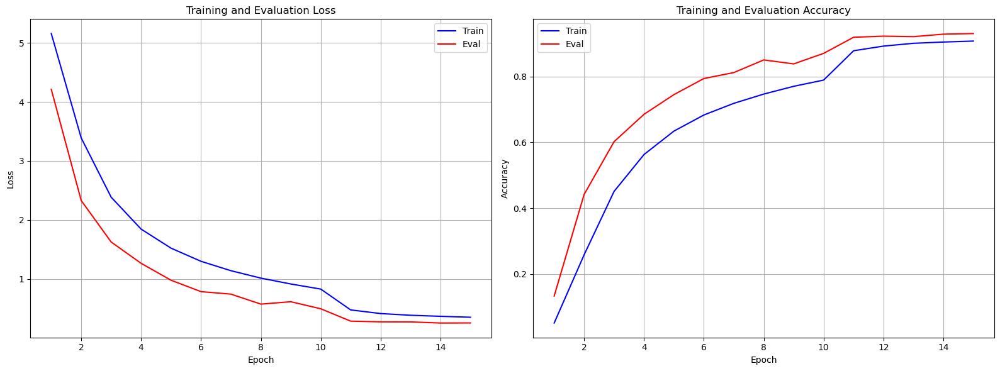

In [ ]:
plot_accuracy_loss(history_df)

In [ ]:
# save checkpoints
from datetime import datetime

current_time = datetime.now().strftime("%Y%m%d%H%M%S")

# Create a directory to save the model
checkpoint_path = Path("checkpoints")
checkpoint_path.mkdir(parents=True, exist_ok=True)

# Create the full model save path
checkpoint_save_path = checkpoint_path / f"{MODEL_NAME}_{current_time}.pth"
torch.save({
    'epoch': END_EPOCH,
    'model_state_dict': effnet.state_dict(),
    'optimizer_state_dict': optimizer.state_dict(),
    'scheduler_state_dict': scheduler.state_dict(),
    'history': history,
}, checkpoint_save_path)

In [24]:
# Load model from models
effnet_trained = EfficientNetV2(num_classes=CLASSES)
effnet_trained.load_state_dict(torch.load('models/effnet_v1.pth'))
effnet_trained.to(DEVICE)

/var/folders/md/rch60bjd0sz1jyk0vg1yh33c0000gn/T/ipykernel_5006/4013150331.py:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  effnet_trained.load_state_dict(torch.load('mod

EfficientNetV2(
  (conv1): Sequential(
    (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): SiLU()
  )
  (mbconv_layers): Sequential(
    (0): MBConv(
      (expand): Identity()
      (depthwise): Sequential(
        (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=32, bias=False)
        (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): SiLU()
      )
      (project): Sequential(
        (0): Conv2d(32, 16, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (1): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
    )
    (1): MBConv(
      (expand): Sequential(
        (0): Conv2d(16, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): 

### Evaluation

#### Load Model

In [25]:
def plot_random_samples_grid(valid_loader, model, classes):
    # Set the model to evaluation mode
    model.eval()
    
    # Collect 16 random samples from the entire validation set
    images_list = []
    labels_list = []
    predicted_list = []
    
    while len(images_list) < 16:
        for images, labels in valid_loader:
            if len(images_list) >= 16:
                break
            
            # Randomly select images from this batch
            for i in range(len(images)):
                if len(images_list) >= 16:
                    break
                
                image = images[i].unsqueeze(0).to(next(model.parameters()).device)
                
                with torch.inference_mode():
                    output = model(image)
                    _, predicted = torch.max(output, 1)
                
                images_list.append(image.squeeze().cpu())
                labels_list.append(labels[i].cpu())
                predicted_list.append(predicted.cpu())
    
    # Plot the images in a 4x4 grid
    fig, axes = plt.subplots(4, 4, figsize=(16, 16))
    
    for i in range(16):
        ax = axes[i // 4, i % 4]
        ax.imshow(images_list[i].permute(1, 2, 0))  # Convert from CxHxW to HxWxC for plotting
        # Check if the prediction is correct
        if predicted_list[i].item() == labels_list[i].item():
            title_color = 'black'

            title_text = f'Pred: {classes[predicted_list[i].item()]} \n Actual: {classes[labels_list[i].item()]}'
        else:
            title_color = 'red'
            title_text = f'Pred: {classes[predicted_list[i].item()]} \n Actual: {classes[labels_list[i].item()]}'
        
        # Set the title with the appropriate color and boldness
        ax.set_title(title_text, color=title_color, fontweight='bold')
        ax.axis('off')  # Hide the axis
    
    plt.tight_layout()
    plt.show()

#### Visualize

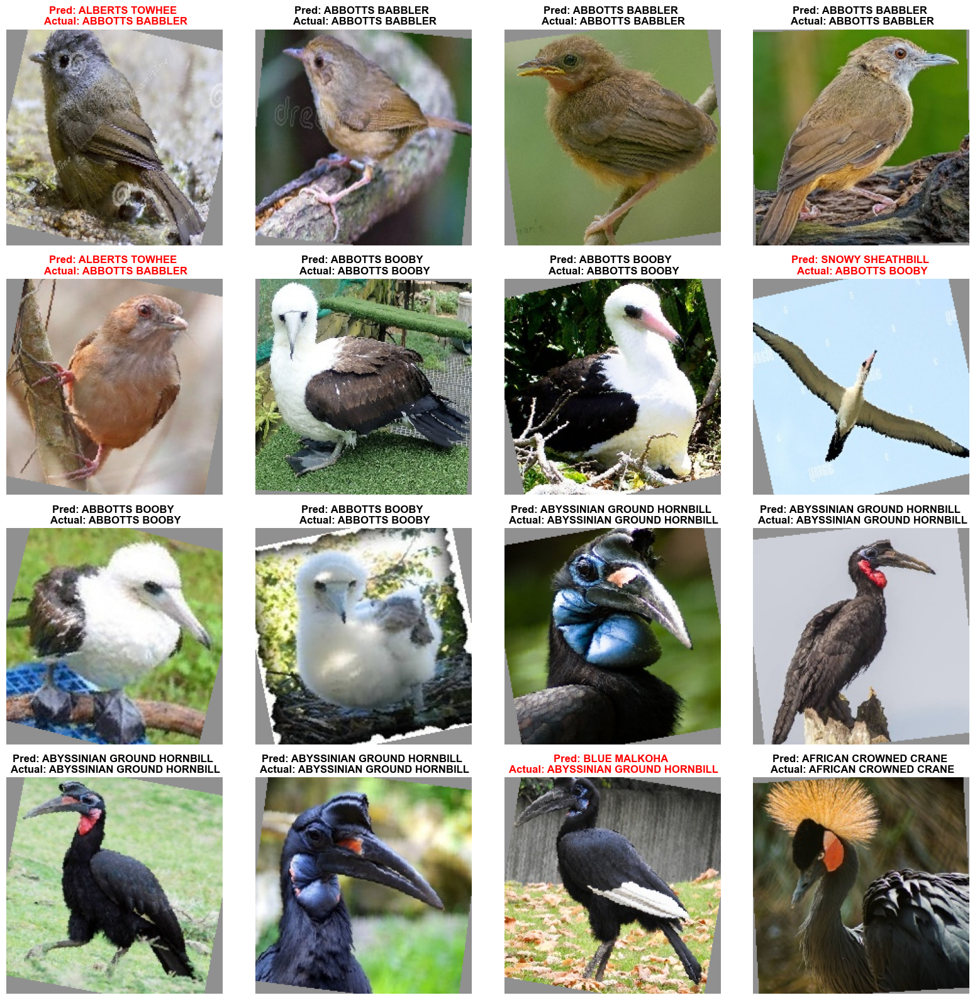

In [26]:
plot_random_samples_grid(valid_loader, effnet_trained, LABELS)

#### Confusion Matrix

In [27]:
def predict_model(model: nn.Module,
              data_loader: torch.utils.data.DataLoader,
              device: torch.device = 'mps'):
    """eval the model

    Args:
        model (nn.Module): The model to test
        data_loader (torch.utils.data.DataLoader): The data loader for the testing data
        device (torch.device, optional): The device used to train the model. Defaults to 'mps'
    """
    
    model.eval()
    targets, preds = [], []
    
    with torch.inference_mode(), tqdm(data_loader, desc=f"Making Prediction") as pbar:
        for input, label in pbar:
            input, label = input.to(device), label.to(device)
                        
            output = model(input)
            pred = output.softmax(dim=1).argmax(dim=1)
            
            targets.append(label.cpu())
            preds.append(pred.cpu())
        
        return {
            "name": model.__class__.__name__,
            "targets": targets,
            "preds": preds,
        }
        
        
def plot_confusion_matrix_range(title, conf_mat, class_names, range_slice=slice(None)):
    # Sum confusion matrix rows to find most confused classes
    class_errors = conf_mat.sum(axis=1) - conf_mat.diagonal()

    # Get the indices for the specified range using the slice object
    sorted_indices = np.argsort(class_errors)
    selected_indices = sorted_indices[range_slice]

    # Select classes from confusion matrix
    conf_mat_range = conf_mat[selected_indices][:, selected_indices]
    class_names_range = [class_names[i] for i in selected_indices]

    # Plot
    plt.figure(figsize=(16, 12))
    sns.heatmap(conf_mat_range, annot=True, fmt='d', cmap='Blues', 
                xticklabels=class_names_range, yticklabels=class_names_range)
    plt.title(f'{title}')
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    plt.tight_layout()
    plt.show()


In [28]:
from torch.utils.data import ConcatDataset, DataLoader

# Join the validation and test datasets into a single dataset for evaluation
eval_dataset = ConcatDataset([valid_dataset, test_dataset])
# Create a DataLoader from the combined dataset
eval_loader = DataLoader(eval_dataset, batch_size=32, shuffle=True)

predictions = predict_model(effnet_trained, eval_loader, DEVICE)

Making Prediction:   0%|          | 0/165 [00:00<?, ?it/s]

In [29]:
preds = torch.cat(predictions['preds'])
targets = torch.cat(predictions['targets'])

In [30]:
# 2. Setup confusion instance and compare predictions to targets
confmat = ConfusionMatrix(num_classes=CLASSES, task="multiclass")
cmat = confmat(preds, targets)

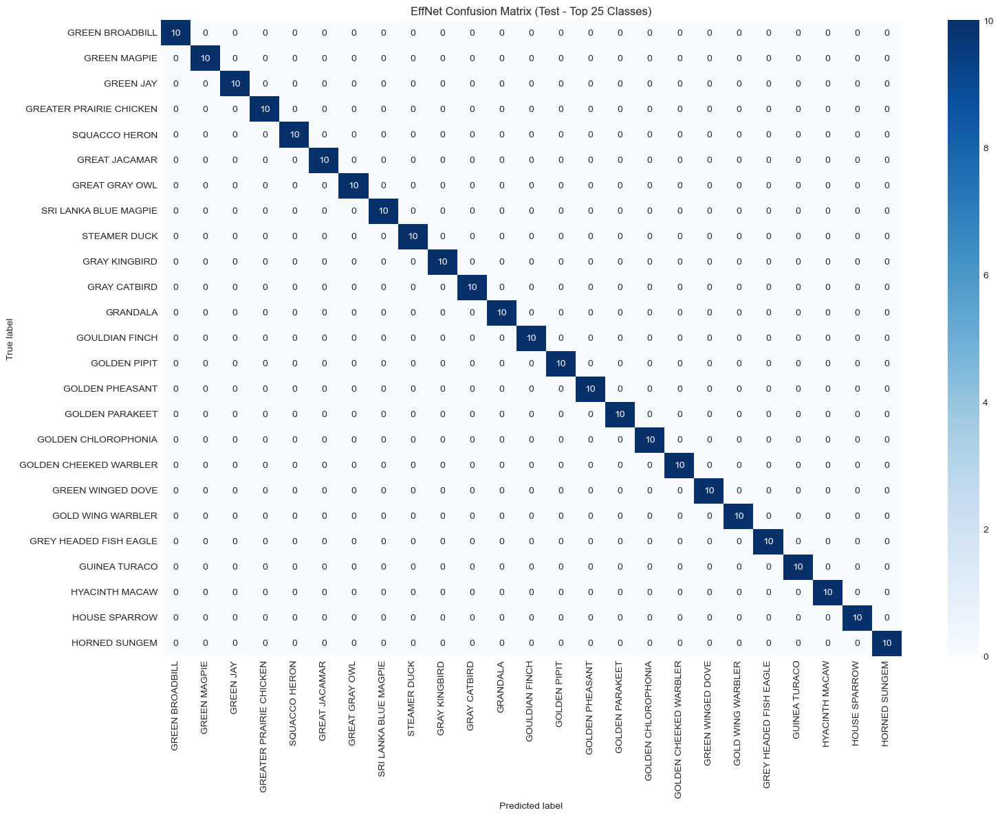

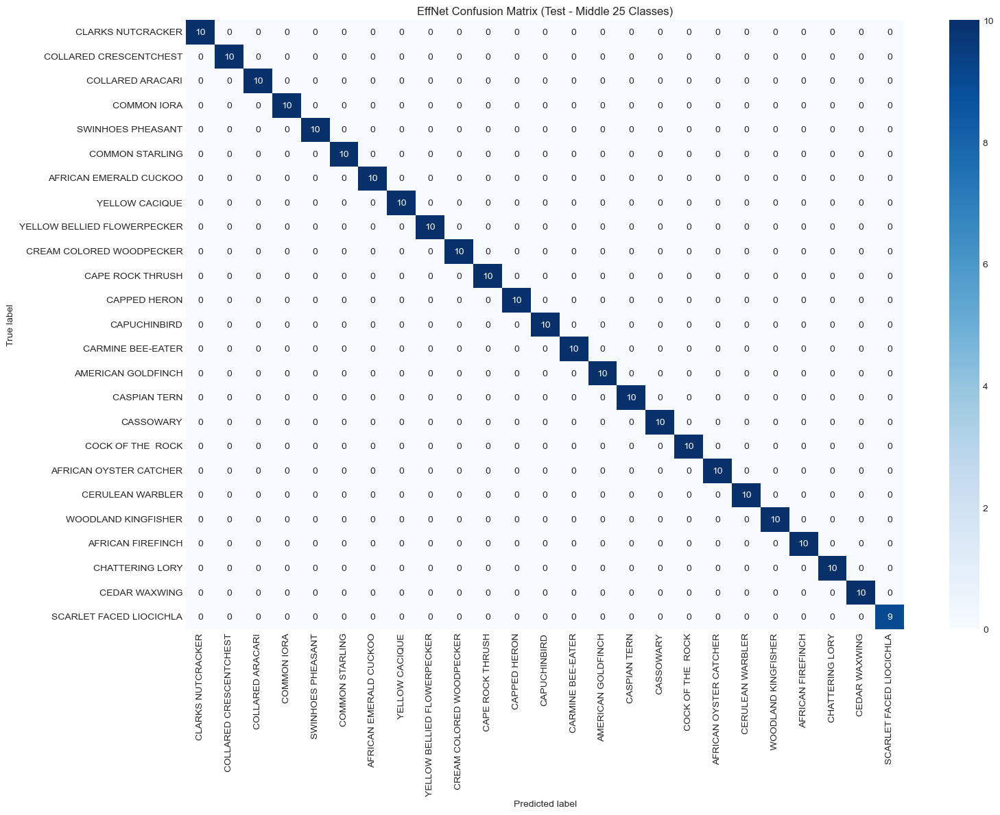

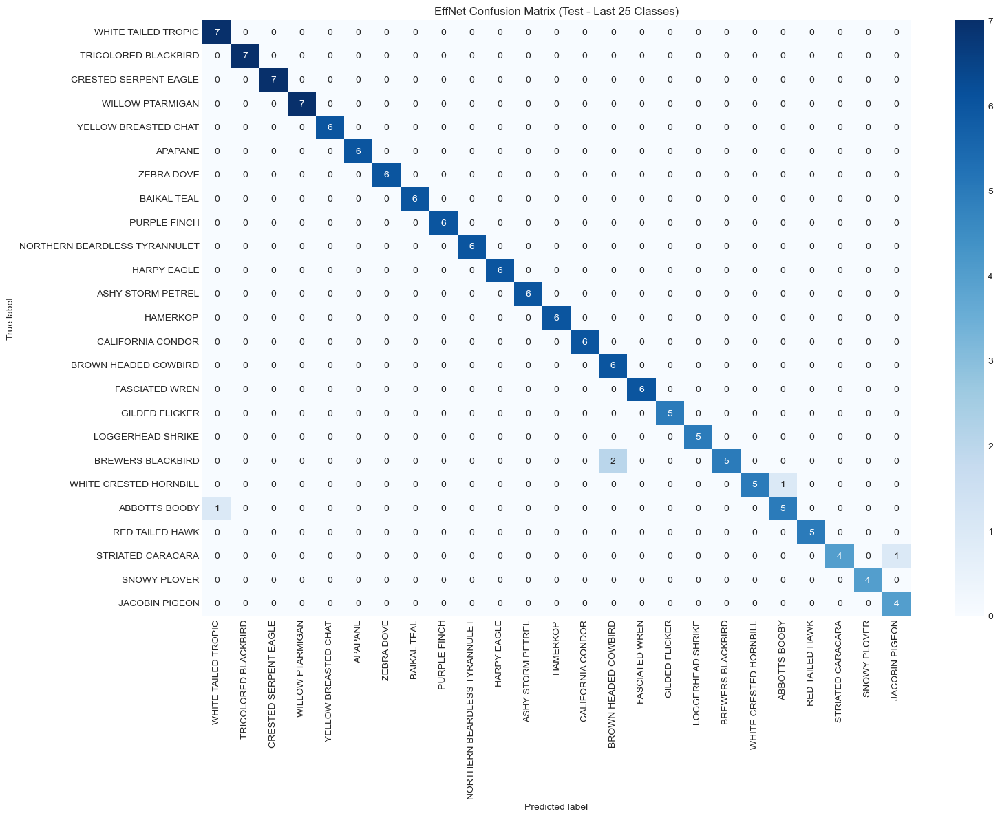

In [31]:
# Calculate the start and end indices for the middle 25 classes
mid_count = 25
mid_start = (CLASSES - mid_count) // 2
mid_end = mid_start + mid_count
# Create a slice object for the middle 25 classes
middle_slice = slice(mid_start, mid_end)

# Example usage
plot_confusion_matrix_range(title="EffNet Confusion Matrix (Test - Top 25 Classes)", 
                            conf_mat=cmat.numpy(), 
                            class_names=LABELS, 
                            range_slice=slice(0, 25))  # Top 25
plot_confusion_matrix_range(title="EffNet Confusion Matrix (Test - Middle 25 Classes)", 
                            conf_mat=cmat.numpy(), 
                            class_names=LABELS, 
                            range_slice=middle_slice)  # Middle 25
plot_confusion_matrix_range(title="EffNet Confusion Matrix (Test - Last 25 Classes)", 
                            conf_mat=cmat.numpy(), 
                            class_names=LABELS, 
                            range_slice=slice(-25, None))  # Top 25

#### Classification Report

In [32]:
from sklearn.metrics import classification_report

num_classes = CLASSES
target_names = ["Class {}".format(target) for i, target in enumerate(LABELS)]
print(classification_report(targets, preds, target_names=target_names))

                                     precision    recall  f1-score   support

              Class ABBOTTS BABBLER       0.73      0.80      0.76        10
                Class ABBOTTS BOOBY       0.83      0.50      0.62        10
   Class ABYSSINIAN GROUND HORNBILL       0.89      0.80      0.84        10
        Class AFRICAN CROWNED CRANE       1.00      0.90      0.95        10
       Class AFRICAN EMERALD CUCKOO       1.00      1.00      1.00        10
            Class AFRICAN FIREFINCH       1.00      1.00      1.00        10
       Class AFRICAN OYSTER CATCHER       1.00      1.00      1.00        10
        Class AFRICAN PIED HORNBILL       0.89      0.80      0.84        10
          Class AFRICAN PYGMY GOOSE       1.00      0.90      0.95        10
                    Class ALBATROSS       0.78      0.70      0.74        10
               Class ALBERTS TOWHEE       0.83      1.00      0.91        10
         Class ALEXANDRINE PARAKEET       0.90      0.90      0.90        1

In [33]:
from torchmetrics import MetricCollection
from torchmetrics.classification import MulticlassAccuracy, MulticlassPrecision, MulticlassRecall, MulticlassF1Score

metrics = MetricCollection([
            MulticlassAccuracy(CLASSES), 
            MulticlassPrecision(CLASSES), 
            MulticlassRecall(CLASSES),
            MulticlassF1Score(CLASSES)
        ])

result = metrics(preds, targets)
# Convert tensor values to Python scalars
result = {k: v.item() if isinstance(v, torch.Tensor) else v for k, v in result.items()}

df = pd.DataFrame(result.items(), columns=['Metric', 'Value'])
df

,Metric,Value
0,MulticlassAccuracy,0.914286
1,MulticlassPrecision,0.923056
2,MulticlassRecall,0.914286
3,MulticlassF1Score,0.913082


## DenseNet

### Class and Instance

In [16]:
import torch
import torch.nn as nn
import torch.nn.functional as F


class DenseLayer(nn.Module):
    def __init__(self, in_channels, growth_rate):
        super(DenseLayer, self).__init__()
        self.bn1 = nn.BatchNorm2d(in_channels)
        self.conv1 = nn.Conv2d(
            in_channels, 4 * growth_rate, kernel_size=1, bias=False)
        self.bn2 = nn.BatchNorm2d(4 * growth_rate)
        self.conv2 = nn.Conv2d(4 * growth_rate, growth_rate,
                               kernel_size=3, padding=1, bias=False)

    def forward(self, x):
        out = self.conv1(F.relu(self.bn1(x)))
        out = self.conv2(F.relu(self.bn2(out)))
        return torch.cat([x, out], 1)


class DenseBlock(nn.Module):
    def __init__(self, in_channels, num_layers, growth_rate):
        super(DenseBlock, self).__init__()
        self.layers = nn.ModuleList([DenseLayer(in_channels + i * growth_rate, growth_rate)
                                     for i in range(num_layers)])

    def forward(self, x):
        for layer in self.layers:
            x = layer(x)
        return x


class TransitionLayer(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(TransitionLayer, self).__init__()
        self.bn = nn.BatchNorm2d(in_channels)
        self.conv = nn.Conv2d(in_channels, out_channels,
                              kernel_size=1, bias=False)

    def forward(self, x):
        out = self.conv(F.relu(self.bn(x)))
        out = F.avg_pool2d(out, 2)
        return out


class DenseNet(nn.Module):
    def __init__(self, growth_rate=32, block_config=(6, 12, 24, 16), num_classes=1000):
        super(DenseNet, self).__init__()

        # Initial convolution
        self.features = nn.Sequential(
            nn.Conv2d(3, 64, kernel_size=7, stride=2, padding=3, bias=False),
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=True),
            nn.MaxPool2d(kernel_size=3, stride=2, padding=1)
        )

        # Dense blocks
        num_features = 64
        for i, num_layers in enumerate(block_config):
            block = DenseBlock(num_features, num_layers, growth_rate)
            self.features.add_module(f'denseblock{i+1}', block)
            num_features += num_layers * growth_rate
            if i != len(block_config) - 1:
                trans = TransitionLayer(num_features, num_features // 2)
                self.features.add_module(f'transition{i+1}', trans)
                num_features = num_features // 2

        # Final batch norm
        self.features.add_module('norm5', nn.BatchNorm2d(num_features))

        # Linear layer
        self.classifier = nn.Linear(num_features, num_classes)

        # Weight initialization
        for m in self.modules():
            if isinstance(m, nn.Conv2d):
                nn.init.kaiming_normal_(m.weight)
            elif isinstance(m, nn.BatchNorm2d):
                nn.init.constant_(m.weight, 1)
                nn.init.constant_(m.bias, 0)
            elif isinstance(m, nn.Linear):
                nn.init.constant_(m.bias, 0)

    def forward(self, x):
        features = self.features(x)
        out = F.relu(features)
        out = F.adaptive_avg_pool2d(out, (1, 1))
        out = torch.flatten(out, 1)
        out = self.classifier(out)
        return out

In [17]:
# create a model instance
torch.manual_seed(SEED)
densenet121_v1 = DenseNet(growth_rate=GROWTH_RATE, num_classes=CLASSES)
densenet121_v1.to(DEVICE)

DenseNet(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (denseblock1): DenseBlock(
      (layers): ModuleList(
        (0): DenseLayer(
          (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (conv2): Conv2d(64, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        )
        (1): DenseLayer(
          (bn1): BatchNorm2d(80, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (conv1): Conv2d(80, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        

### Functions

In [ ]:
# define the loss function and the optimizer
# modify based on your task
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(densenet121_v1.parameters(), lr=0.01)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=10, gamma=0.1)
accuracy_fn = Accuracy(task="multiclass", num_classes=CLASSES).to(DEVICE)

# writer to tensorboard
# !!!! remember change the writer name to <model_name>_<version>, dont't overwrite the previous model
writer = SummaryWriter('runs/densenet121_v1')

### Training

In [ ]:
# train the model
history = train_and_evaluate(model=densenet121_v1,
                             train_loader=train_loader,
                             test_loader=test_loader,
                             criterion=criterion,
                             optimizer=optimizer,
                             scheduler=scheduler,
                             accuracy_fn=accuracy_fn,
                             writer=writer,
                             device=DEVICE,
                             start_epoch=6,
                             end_epoch=10,
                             name='densenet121_v1')

Epochs:   0%|          | 0/5 [00:00<?, ?epoch/s]

Epoch 6 | Training:   0%|          | 0/2645 [00:00<?, ?batch/s]

Epoch 6 | Evaluating:   0%|          | 0/83 [00:00<?, ?batch/s]

Epoch 7 | Training:   0%|          | 0/2645 [00:00<?, ?batch/s]

Epoch 7 | Evaluating:   0%|          | 0/83 [00:00<?, ?batch/s]

Epoch 8 | Training:   0%|          | 0/2645 [00:00<?, ?batch/s]

Epoch 8 | Evaluating:   0%|          | 0/83 [00:00<?, ?batch/s]

Epoch 9 | Training:   0%|          | 0/2645 [00:00<?, ?batch/s]

Epoch 9 | Evaluating:   0%|          | 0/83 [00:00<?, ?batch/s]

Epoch 10 | Training:   0%|          | 0/2645 [00:00<?, ?batch/s]

Epoch 10 | Evaluating:   0%|          | 0/83 [00:00<?, ?batch/s]

### Save Model and History

In [ ]:
# save the model
save_model(densenet121_v1, 'densenet121_v1')

PosixPath('models/densenet121_v1.pth')

In [ ]:
# Create DataFrames for train and eval data
train_df = pd.DataFrame(history['train'])
eval_df = pd.DataFrame(history['eval'])

# Add a column to distinguish between train and eval data
train_df['set'] = 'train'
eval_df['set'] = 'eval'

# Combine the two DataFrames
history_df = pd.concat([train_df, eval_df], ignore_index=True)
history_df

,epoch,loss,accuracy,set
0,6,1.106347,0.727029,train
1,7,1.000563,0.750074,train
2,8,0.907945,0.771445,train
3,9,0.837230,0.786863,train
4,10,0.773527,0.801728,train
5,6,0.638834,0.833584,eval
6,7,0.695693,0.815136,eval
7,8,0.488435,0.867093,eval
8,9,0.506348,0.856928,eval
9,10,0.419652,0.884036,eval


In [ ]:
# save the history to a csv file
save_history(history_df, 'densenet121_v1')

In [ ]:
plot_accuracy_loss(history_df)

In [35]:
# Load model from models
densenet121_v1_trained = DenseNet(growth_rate=GROWTH_RATE, num_classes=CLASSES)
densenet121_v1_trained.load_state_dict(torch.load('models/densenet121_v1.pth'))
densenet121_v1_trained.to(DEVICE)

/var/folders/md/rch60bjd0sz1jyk0vg1yh33c0000gn/T/ipykernel_5006/2823307344.py:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  densenet121_v1_trained.load_state_dict(torch.l

DenseNet(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (denseblock1): DenseBlock(
      (layers): ModuleList(
        (0): DenseLayer(
          (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (conv2): Conv2d(64, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        )
        (1): DenseLayer(
          (bn1): BatchNorm2d(80, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (conv1): Conv2d(80, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        

### Evaluation

#### Load Model

In [40]:
# Load model from models
densenet121_v1_trained = DenseNet(growth_rate=GROWTH_RATE, num_classes=CLASSES)
densenet121_v1_trained.load_state_dict(torch.load('models/densenet121_v1.pth'))
densenet121_v1_trained.to(DEVICE)

/var/folders/md/rch60bjd0sz1jyk0vg1yh33c0000gn/T/ipykernel_32941/2823307344.py:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  densenet121_v1_trained.load_state_dict(torch.

DenseNet(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (denseblock1): DenseBlock(
      (layers): ModuleList(
        (0): DenseLayer(
          (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (conv2): Conv2d(64, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        )
        (1): DenseLayer(
          (bn1): BatchNorm2d(80, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (conv1): Conv2d(80, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        

#### Visualize

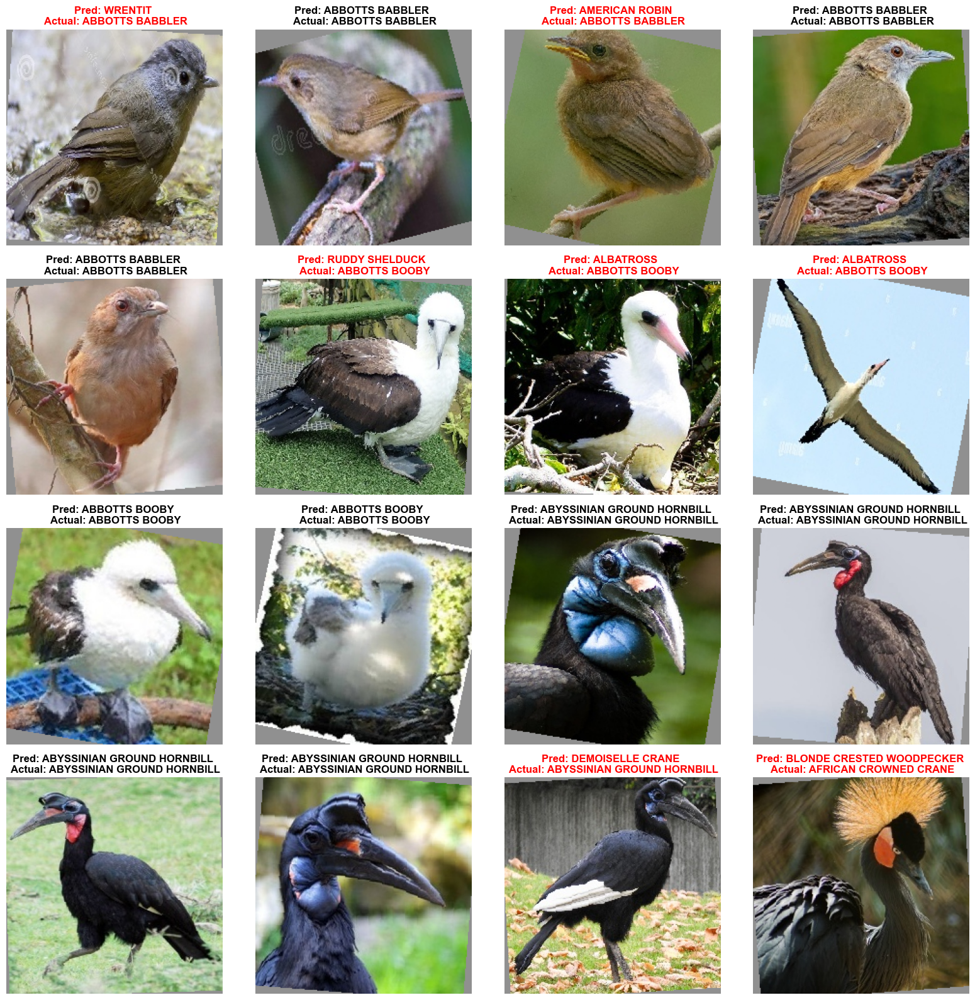

In [41]:
plot_random_samples_grid(valid_loader, densenet121_v1_trained, LABELS)

#### Confusion Matrix

In [42]:
from torch.utils.data import ConcatDataset, DataLoader

# Join the validation and test datasets into a single dataset for evaluation
eval_dataset = ConcatDataset([valid_dataset, test_dataset])
# Create a DataLoader from the combined dataset
eval_loader = DataLoader(eval_dataset, batch_size=32, shuffle=True)

predictions = predict_model(densenet121_v1_trained, eval_loader, DEVICE)

Making Prediction:   0%|          | 0/165 [00:00<?, ?it/s]

In [43]:
preds = torch.cat(predictions['preds'])
targets = torch.cat(predictions['targets'])

In [44]:
import torchmetrics
import mlxtend
from torchmetrics import ConfusionMatrix
from mlxtend.plotting import plot_confusion_matrix

# 2. Setup confusion instance and compare predictions to targets
confmat = ConfusionMatrix(num_classes=CLASSES, task="multiclass")

cmat = confmat(preds, targets)

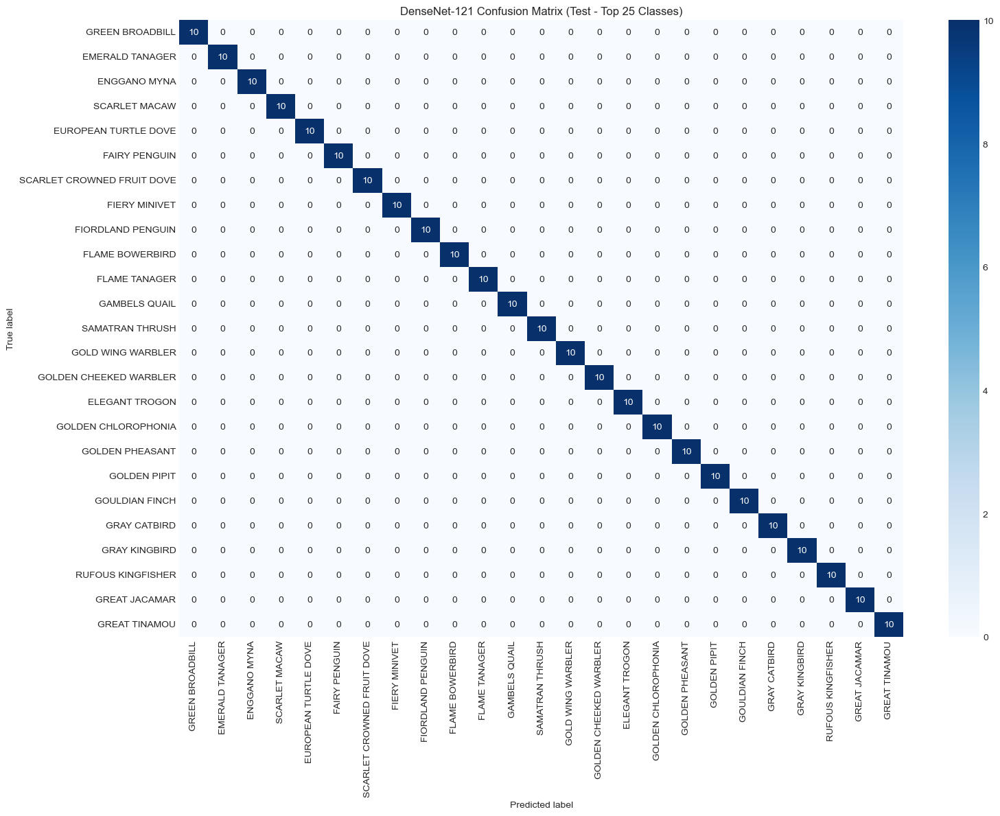

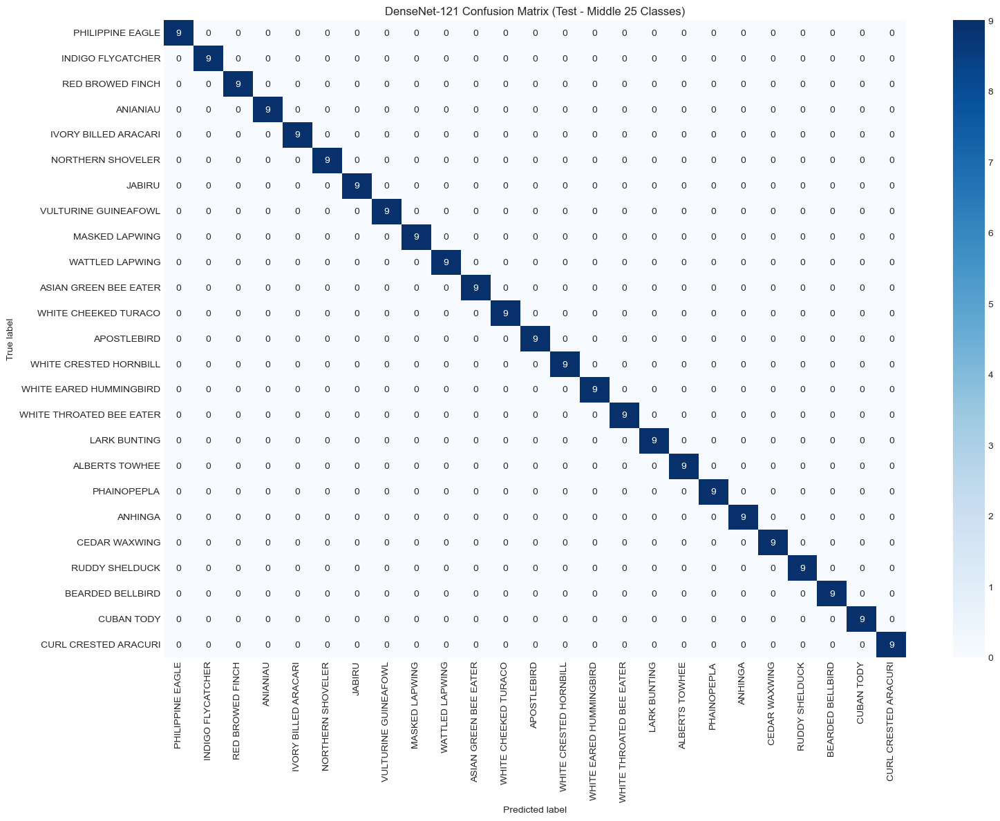

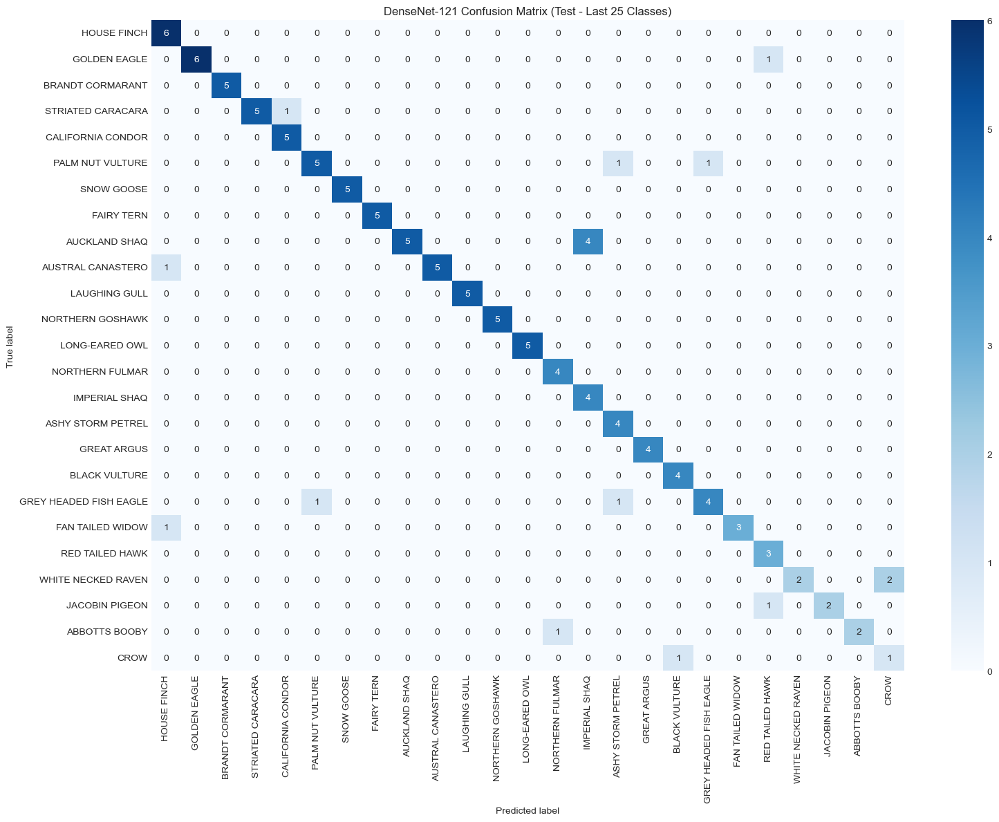

In [45]:
# Calculate the start and end indices for the middle 25 classes
mid_count = 25
mid_start = (CLASSES - mid_count) // 2
mid_end = mid_start + mid_count
# Create a slice object for the middle 25 classes
middle_slice = slice(mid_start, mid_end)

# Example usage
plot_confusion_matrix_range(title="DenseNet-121 Confusion Matrix (Test - Top 25 Classes)",
                            conf_mat=cmat.numpy(),
                            class_names=LABELS,
                            range_slice=slice(0, 25))  # Top 25
plot_confusion_matrix_range(title="DenseNet-121 Confusion Matrix (Test - Middle 25 Classes)",
                            conf_mat=cmat.numpy(),
                            class_names=LABELS,
                            range_slice=middle_slice)  # Middle 25
plot_confusion_matrix_range(title="DenseNet-121 Confusion Matrix (Test - Last 25 Classes)",
                            conf_mat=cmat.numpy(),
                            class_names=LABELS,
                            range_slice=slice(-25, None))  # Top 25

#### Classification Report

In [46]:
from sklearn.metrics import classification_report

num_classes = CLASSES
target_names = ["Class {}".format(target) for i, target in enumerate(LABELS)]
print(classification_report(targets, preds, target_names=target_names))

                                     precision    recall  f1-score   support

              Class ABBOTTS BABBLER       0.73      0.80      0.76        10
                Class ABBOTTS BOOBY       0.67      0.20      0.31        10
   Class ABYSSINIAN GROUND HORNBILL       1.00      0.70      0.82        10
        Class AFRICAN CROWNED CRANE       1.00      0.80      0.89        10
       Class AFRICAN EMERALD CUCKOO       0.83      1.00      0.91        10
            Class AFRICAN FIREFINCH       1.00      0.90      0.95        10
       Class AFRICAN OYSTER CATCHER       0.77      1.00      0.87        10
        Class AFRICAN PIED HORNBILL       1.00      0.80      0.89        10
          Class AFRICAN PYGMY GOOSE       1.00      1.00      1.00        10
                    Class ALBATROSS       0.62      0.80      0.70        10
               Class ALBERTS TOWHEE       1.00      0.90      0.95        10
         Class ALEXANDRINE PARAKEET       0.91      1.00      0.95        1

In [47]:
from torchmetrics import MetricCollection
from torchmetrics.classification import MulticlassAccuracy, MulticlassPrecision, MulticlassRecall, MulticlassF1Score

metrics = MetricCollection([
    MulticlassAccuracy(CLASSES),
    MulticlassPrecision(CLASSES),
    MulticlassRecall(CLASSES),
    MulticlassF1Score(CLASSES)
])

result = metrics(preds, targets)
# Convert tensor values to Python scalars
result = {k: v.item() if isinstance(v, torch.Tensor)
          else v for k, v in result.items()}

df = pd.DataFrame(result.items(), columns=['Metric', 'Value'])
df

,Metric,Value
0,MulticlassAccuracy,0.872381
1,MulticlassPrecision,0.889836
2,MulticlassRecall,0.872381
3,MulticlassF1Score,0.870967


## ResNet

### Class and Instance

In [18]:
class BasicBlock(nn.Module):
    expansion = 1  # No expansion in ResNet-34

    def __init__(self, in_channels, out_channels, stride=1, downsample=None):
        super(BasicBlock, self).__init__()
        self.conv1 = nn.Conv2d(in_channels, out_channels, kernel_size=3, stride=stride, padding=1, bias=False)
        self.bn1 = nn.BatchNorm2d(out_channels)
        
        self.conv2 = nn.Conv2d(out_channels, out_channels, kernel_size=3, stride=1, padding=1, bias=False)
        self.bn2 = nn.BatchNorm2d(out_channels)
        
        self.relu = nn.ReLU(inplace=True)
        self.downsample = downsample

    def forward(self, x):
        identity = x

        out = self.conv1(x)
        out = self.bn1(out)
        out = self.relu(out)

        out = self.conv2(out)
        out = self.bn2(out)

        if self.downsample is not None:
            identity = self.downsample(x)

        out += identity
        out = self.relu(out)

        return out

class ResNet34(nn.Module):
    def __init__(self, num_classes=1000):
        super(ResNet34, self).__init__()
        self.in_channels = 64
        
        # Initial convolution and max-pooling layers
        self.conv1 = nn.Conv2d(3, 64, kernel_size=7, stride=2, padding=3, bias=False)
        self.bn1 = nn.BatchNorm2d(64)
        self.relu = nn.ReLU(inplace=True)
        self.maxpool = nn.MaxPool2d(kernel_size=3, stride=2, padding=1)

        # Residual blocks for each layer
        self.layer1 = self._make_layer(BasicBlock, 64, 3, stride=1)
        self.layer2 = self._make_layer(BasicBlock, 128, 4, stride=2)
        self.layer3 = self._make_layer(BasicBlock, 256, 6, stride=2)
        self.layer4 = self._make_layer(BasicBlock, 512, 3, stride=2)

        # Final layers
        self.avgpool = nn.AdaptiveAvgPool2d((1, 1))
        self.fc = nn.Linear(512 * BasicBlock.expansion, num_classes)

    def _make_layer(self, block, out_channels, blocks, stride=1):
        downsample = None
        if stride != 1 or self.in_channels != out_channels * block.expansion:
            downsample = nn.Sequential(
                nn.Conv2d(self.in_channels, out_channels * block.expansion, kernel_size=1, stride=stride, bias=False),
                nn.BatchNorm2d(out_channels * block.expansion),
            )

        layers = []
        layers.append(block(self.in_channels, out_channels, stride, downsample))
        self.in_channels = out_channels * block.expansion
        for _ in range(1, blocks):
            layers.append(block(self.in_channels, out_channels))

        return nn.Sequential(*layers)

    def forward(self, x):
        x = self.conv1(x)
        x = self.bn1(x)
        x = self.relu(x)
        x = self.maxpool(x)

        x = self.layer1(x)
        x = self.layer2(x)
        x = self.layer3(x)
        x = self.layer4(x)

        x = self.avgpool(x)
        x = torch.flatten(x, 1)
        x = self.fc(x)

        return x

In [19]:
# create a model instance
torch.manual_seed(SEED)
model = ResNet34(num_classes=CLASSES)
model.to(DEVICE)

ResNet34(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, ker

### Functions

In [ ]:
# define the loss function and the optimizer
# modify based on your task
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.01)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=10, gamma=0.1)
accuracy_fn = Accuracy(task="multiclass", num_classes=CLASSES).to(DEVICE)

# writer to tensorboard
# !!!! remember change the writer name to <model_name>_<version>, dont't overwrite the previous model
writer = SummaryWriter('runs/resnet_v1')

### Training

In [ ]:
# train the model
history = train_and_evaluate(model=model,
                             train_loader=train_loader,
                             test_loader=test_loader,
                             criterion=criterion,
                             optimizer=optimizer,
                             scheduler=scheduler,
                             accuracy_fn=accuracy_fn,
                             writer=writer,
                             device=DEVICE,
                             start_epoch=1,
                             end_epoch=10,
                             name='resnet_v1')

Epochs:   0%|          | 0/10 [00:00<?, ?epoch/s]

Epoch 1 | Training:   0%|          | 0/2645 [00:00<?, ?batch/s]

Epoch 1 | Evaluating:   0%|          | 0/83 [00:00<?, ?batch/s]

Epoch 2 | Training:   0%|          | 0/2645 [00:00<?, ?batch/s]

Epoch 2 | Evaluating:   0%|          | 0/83 [00:00<?, ?batch/s]

Epoch 3 | Training:   0%|          | 0/2645 [00:00<?, ?batch/s]

Epoch 3 | Evaluating:   0%|          | 0/83 [00:00<?, ?batch/s]

Epoch 4 | Training:   0%|          | 0/2645 [00:00<?, ?batch/s]

Epoch 4 | Evaluating:   0%|          | 0/83 [00:00<?, ?batch/s]

Epoch 5 | Training:   0%|          | 0/2645 [00:00<?, ?batch/s]

Epoch 5 | Evaluating:   0%|          | 0/83 [00:00<?, ?batch/s]

Epoch 6 | Training:   0%|          | 0/2645 [00:00<?, ?batch/s]

Epoch 6 | Evaluating:   0%|          | 0/83 [00:00<?, ?batch/s]

Epoch 7 | Training:   0%|          | 0/2645 [00:00<?, ?batch/s]

Epoch 7 | Evaluating:   0%|          | 0/83 [00:00<?, ?batch/s]

Epoch 8 | Training:   0%|          | 0/2645 [00:00<?, ?batch/s]

Epoch 8 | Evaluating:   0%|          | 0/83 [00:00<?, ?batch/s]

Epoch 9 | Training:   0%|          | 0/2645 [00:00<?, ?batch/s]

Epoch 9 | Evaluating:   0%|          | 0/83 [00:00<?, ?batch/s]

Epoch 10 | Training:   0%|          | 0/2645 [00:00<?, ?batch/s]

Epoch 10 | Evaluating:   0%|          | 0/83 [00:00<?, ?batch/s]

### Save Model and History

In [ ]:
# save the model
save_model(model, 'resnet_v1')

WindowsPath('models/resnet_v1.pth')

In [ ]:
# Create DataFrames for train and eval data
train_df = pd.DataFrame(history['train'])
eval_df = pd.DataFrame(history['eval'])

# Add a column to distinguish between train and eval data
train_df['set'] = 'train'
eval_df['set'] = 'eval'

# Combine the two DataFrames
history_df = pd.concat([train_df, eval_df], ignore_index=True)
history_df

,epoch,loss,accuracy,set
0,1,5.824685,0.013178,train
1,2,3.826832,0.209612,train
2,3,2.161547,0.503095,train
3,4,1.501339,0.644191,train
4,5,1.145403,0.718019,train
5,6,0.920328,0.769145,train
6,7,0.753518,0.805675,train
7,8,0.640124,0.832165,train
8,9,0.548206,0.852314,train
9,10,0.478481,0.870291,train


In [ ]:
# save the history to a csv file
save_history(history_df, 'resnet_v1')

In [ ]:
# load the model
resnet_trained = ResNet34(num_classes=CLASSES)
resnet_trained.load_state_dict(torch.load('models/resnet_v1.pth'))
resnet_trained.to(DEVICE)

# baseline_trained = Baseline(input_features=CHANNELS, output_features=CLASSES)
# baseline_trained.load_state_dict(torch.load('models/resnet_v1.pth'))

C:\Users\SHUAIGEE\AppData\Local\Temp\ipykernel_23952\2200723718.py:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  resnet_trained.load_state_dict(torch.load('models/resnet_

ResNet34(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, ker

In [ ]:
# Load model from models
effnet_trained = EfficientNetV2(num_classes=CLASSES)
effnet_trained.load_state_dict(torch.load('models/effnet_v1.pth'))
effnet_trained.to(DEVICE)

/var/folders/md/rch60bjd0sz1jyk0vg1yh33c0000gn/T/ipykernel_2148/4013150331.py:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  effnet_trained.load_state_dict(torch.load('mod

EfficientNetV2(
  (conv1): Sequential(
    (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): SiLU()
  )
  (mbconv_layers): Sequential(
    (0): MBConv(
      (expand): Identity()
      (depthwise): Sequential(
        (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=32, bias=False)
        (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): SiLU()
      )
      (project): Sequential(
        (0): Conv2d(32, 16, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (1): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
    )
    (1): MBConv(
      (expand): Sequential(
        (0): Conv2d(16, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): 

### Evaluation

#### Load Model

#### Visualize

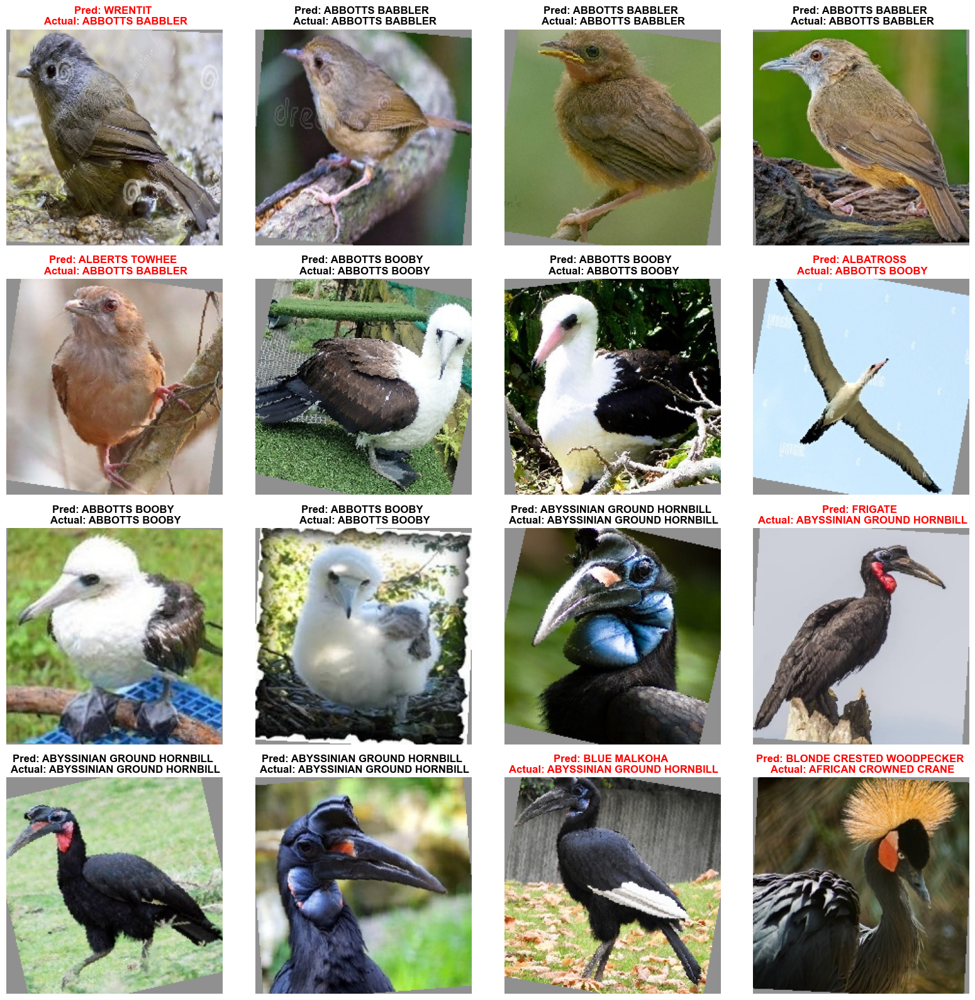

In [45]:
plot_random_samples_grid(valid_loader, effnet_trained, LABELS)

#### Confusion Matrix

In [46]:
from torch.utils.data import ConcatDataset, DataLoader

# Join the validation and test datasets into a single dataset for evaluation
eval_dataset = ConcatDataset([valid_dataset, test_dataset])
# Create a DataLoader from the combined dataset
eval_loader = DataLoader(eval_dataset, batch_size=32, shuffle=True)

predictions = predict_model(effnet_trained, eval_loader, DEVICE)

Making Prediction:   0%|          | 0/165 [00:00<?, ?it/s]

In [52]:
preds = torch.cat(predictions['preds'])
targets = torch.cat(predictions['targets'])

In [53]:
# 2. Setup confusion instance and compare predictions to targets
confmat = ConfusionMatrix(num_classes=CLASSES, task="multiclass")
cmat = confmat(preds, targets)

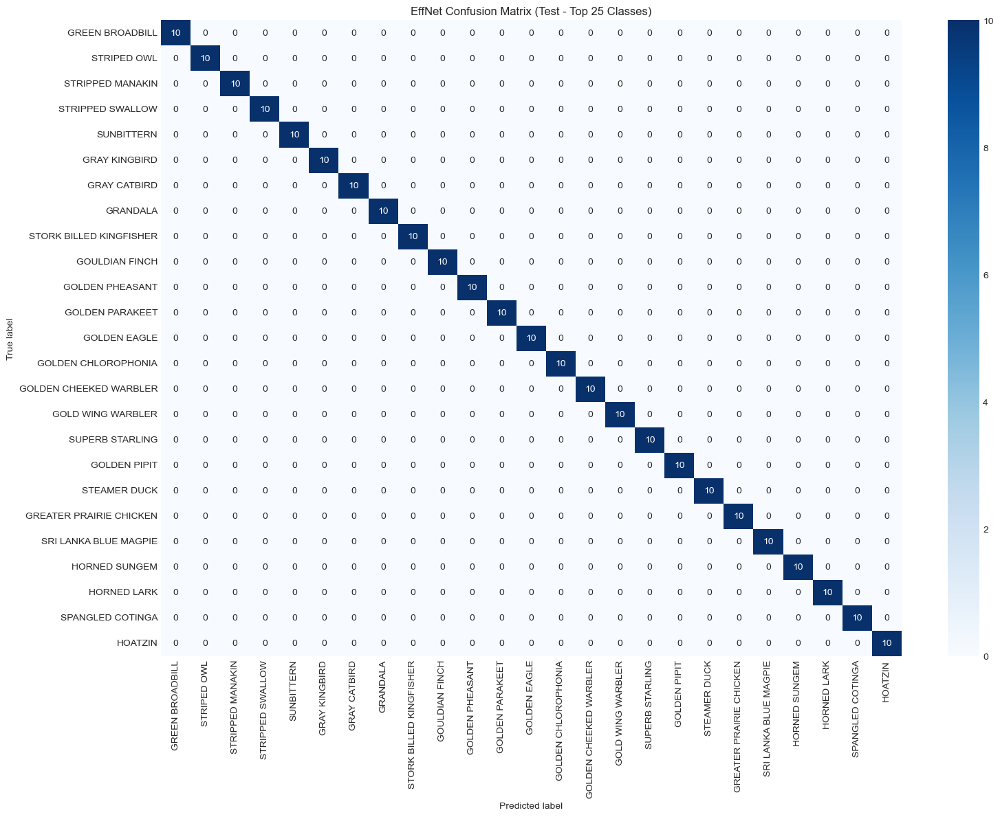

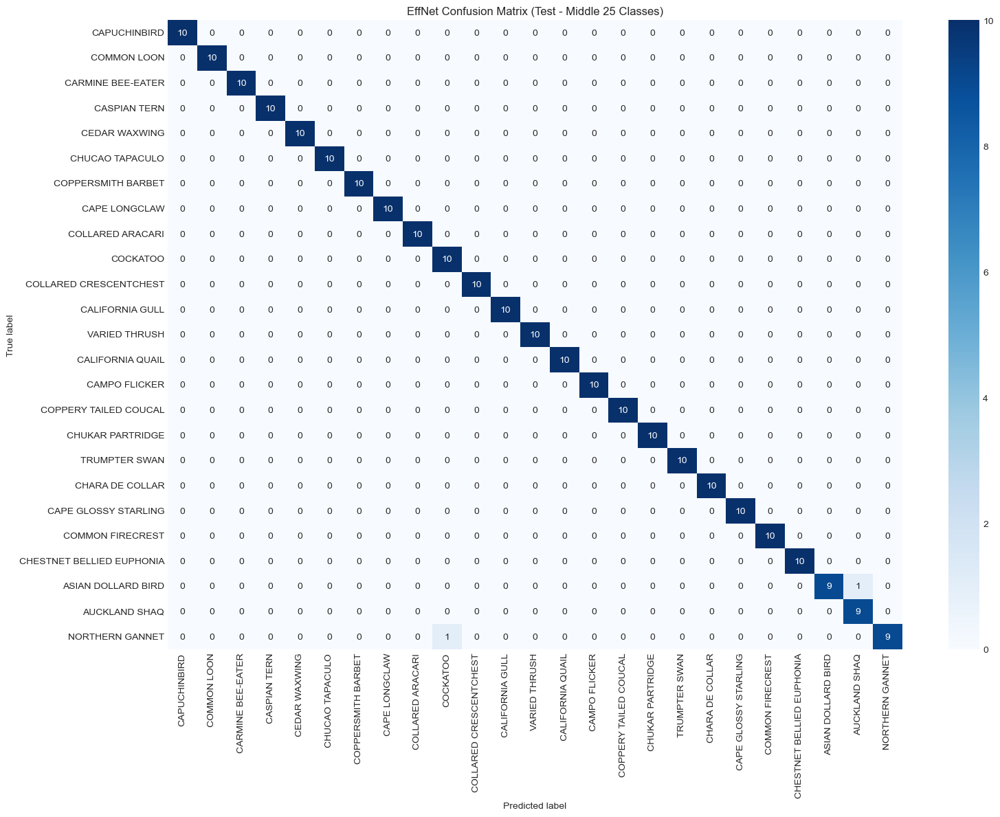

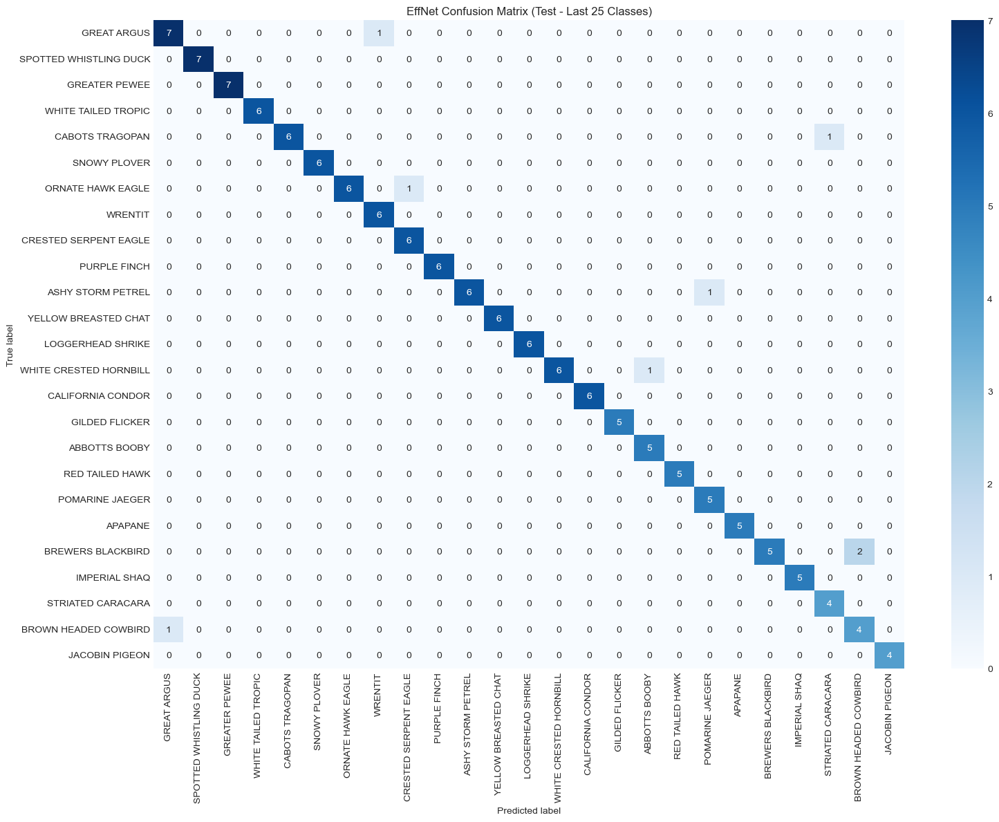

In [54]:
# Calculate the start and end indices for the middle 25 classes
mid_count = 25
mid_start = (CLASSES - mid_count) // 2
mid_end = mid_start + mid_count
# Create a slice object for the middle 25 classes
middle_slice = slice(mid_start, mid_end)

# Example usage
plot_confusion_matrix_range(title="EffNet Confusion Matrix (Test - Top 25 Classes)", 
                            conf_mat=cmat.numpy(), 
                            class_names=LABELS, 
                            range_slice=slice(0, 25))  # Top 25
plot_confusion_matrix_range(title="EffNet Confusion Matrix (Test - Middle 25 Classes)", 
                            conf_mat=cmat.numpy(), 
                            class_names=LABELS, 
                            range_slice=middle_slice)  # Middle 25
plot_confusion_matrix_range(title="EffNet Confusion Matrix (Test - Last 25 Classes)", 
                            conf_mat=cmat.numpy(), 
                            class_names=LABELS, 
                            range_slice=slice(-25, None))  # Top 25

#### Classification Report

In [55]:
from sklearn.metrics import classification_report

num_classes = CLASSES
target_names = ["Class {}".format(target) for i, target in enumerate(LABELS)]
print(classification_report(targets, preds, target_names=target_names))

                                     precision    recall  f1-score   support

              Class ABBOTTS BABBLER       0.80      0.80      0.80        10
                Class ABBOTTS BOOBY       0.83      0.50      0.62        10
   Class ABYSSINIAN GROUND HORNBILL       0.90      0.90      0.90        10
        Class AFRICAN CROWNED CRANE       1.00      0.90      0.95        10
       Class AFRICAN EMERALD CUCKOO       1.00      1.00      1.00        10
            Class AFRICAN FIREFINCH       1.00      1.00      1.00        10
       Class AFRICAN OYSTER CATCHER       1.00      1.00      1.00        10
        Class AFRICAN PIED HORNBILL       0.90      0.90      0.90        10
          Class AFRICAN PYGMY GOOSE       1.00      0.90      0.95        10
                    Class ALBATROSS       0.80      0.80      0.80        10
               Class ALBERTS TOWHEE       0.69      0.90      0.78        10
         Class ALEXANDRINE PARAKEET       0.91      1.00      0.95        1

In [56]:
from torchmetrics import MetricCollection
from torchmetrics.classification import MulticlassAccuracy, MulticlassPrecision, MulticlassRecall, MulticlassF1Score

metrics = MetricCollection([
            MulticlassAccuracy(CLASSES), 
            MulticlassPrecision(CLASSES), 
            MulticlassRecall(CLASSES),
            MulticlassF1Score(CLASSES)
        ])

result = metrics(preds, targets)
# Convert tensor values to Python scalars
result = {k: v.item() if isinstance(v, torch.Tensor) else v for k, v in result.items()}

df = pd.DataFrame(result.items(), columns=['Metric', 'Value'])
df

,Metric,Value
0,MulticlassAccuracy,0.913524
1,MulticlassPrecision,0.919990
2,MulticlassRecall,0.913524
3,MulticlassF1Score,0.912115


# Model Tuning

## EffcientNet

### Load model and functions

In [ ]:
import os

import optuna
from optuna.trial import TrialState
from torchvision import datasets
from torchvision import transforms
from optuna.storages import RDBStorage

from helper_functions import train_model, eval_model

In [ ]:
CLASSES = len(train_dataset.classes)
EPOCHS = 10
N_TRAIN_EXAMPLES = train_dataset.__len__() * 0.20
N_VALID_EXAMPLES = valid_dataset.__len__() * 0.20
N_TRAIN_EXAMPLES, N_VALID_EXAMPLES

(16927.0, 525.0)

In [ ]:
# Step 1: Define the Objective Function

def objective(trial):
    # Define hyperparameters to optimize
    batch_size = trial.suggest_categorical('batch_size', [8, 16, 32])
    optimizer_name = trial.suggest_categorical("optimizer", ["Adam", "RMSprop", "SGD"])
    lr = trial.suggest_float("lr", 1e-5, 1e-1, log=True)
    
    # Early stopping parameters
    patience = trial.suggest_int('patience', 5, 20)
    min_delta = trial.suggest_float('min_delta', 1e-4, 1e-2, log=True)

    # Data loaders
    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
    valid_loader = DataLoader(valid_dataset, batch_size=batch_size, shuffle=False)

    # Load model
    model = EfficientNetV2(num_classes=CLASSES)                     # Change based on selected model
    model.load_state_dict(torch.load('models/effnet_v1.pth'))       # Change based on selected model
    model.to(DEVICE)

    optimizer = getattr(optim, optimizer_name)(model.parameters(), lr=lr)

    # Training loop with early stopping
    best_val_acc = 0
    epochs_no_improve = 0
    
    epoch_iterator = tqdm(range(1, EPOCHS + 1), desc=f"Trial {trial.number} | Epoch", unit="epoch", leave=False)
    for epoch in epoch_iterator:
        
        model.train()
        epoch_iterator.set_description(f"Trial {trial.number} | Train | Epoch {epoch}")
        
        for batch_idx, (inputs, labels) in enumerate(train_loader):
            # Limiting training data for faster epochs.
            if batch_idx * batch_size >= N_TRAIN_EXAMPLES:
                break
            
            inputs, labels = inputs.to(DEVICE), labels.to(DEVICE)
            optimizer.zero_grad()
            outputs = model(inputs)
            loss = F.cross_entropy(outputs, labels)
            loss.backward()
            optimizer.step()

        # Validation of the model.
        epoch_iterator.set_description(f"Trial {trial.number} | Valid | Epoch {epoch}")
        model.eval()
        correct = 0
        val_examples = 0
        with torch.inference_mode():
            for batch_idx, (inputs, labels) in enumerate(valid_loader):
                # Limiting validation data.
                if val_examples >= N_VALID_EXAMPLES:
                    break
                inputs, labels = inputs.to(DEVICE), labels.to(DEVICE)
                outputs = model(inputs)
                preds = outputs.argmax(dim=1, keepdim=True)
                correct += preds.eq(labels.view_as(preds)).sum().item()
                val_examples += inputs.size(0)

        accuracy = correct / min(len(valid_loader.dataset), N_VALID_EXAMPLES)
        trial.report(accuracy, epoch)

        # Handle pruning based on the intermediate value.
        if trial.should_prune():
            raise optuna.exceptions.TrialPruned()
        
        # Early stopping
        if accuracy > best_val_acc + min_delta:
            best_val_acc = accuracy
            epochs_no_improve = 0
        else:
            epochs_no_improve += 1
        
        if epochs_no_improve == patience:
            print(f"Early stopping triggered after epoch {epoch+1}")
            break

    return best_val_acc


study_name = "efficientnet_optimization"
storage = RDBStorage('sqlite:///db.sqlite3')
# Create a study object and specify the direction is 'maximize'.
study = optuna.create_study(study_name=study_name, storage=storage, direction='maximize', load_if_exists=True)

# Optimize
study.optimize(objective, n_trials=10)

pruned_trials = study.get_trials(deepcopy=False, states=[TrialState.PRUNED])
complete_trials = study.get_trials(deepcopy=False, states=[TrialState.COMPLETE])

print("Study statistics: ")
print("  Number of finished trials: ", len(study.trials))
print("  Number of pruned trials: ", len(pruned_trials))
print("  Number of complete trials: ", len(complete_trials))

# Print results
print('Best trial:')
trial = study.best_trial
print('Value: ', trial.value)
print('Params: ')
for key, value in trial.params.items():
    print('    {}: {}'.format(key, value))
    

[I 2024-08-14 22:16:30,091] A new study created in RDB with name: efficientnet_optimization
/var/folders/md/rch60bjd0sz1jyk0vg1yh33c0000gn/T/ipykernel_6731/3636056403.py:19: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any 

Trial 0 | Epoch:   0%|          | 0/10 [00:00<?, ?epoch/s]

[I 2024-08-14 23:16:03,603] Trial 0 finished with value: 0.900952380952381 and parameters: {'batch_size': 8, 'optimizer': 'RMSprop', 'lr': 2.1939817938085282e-05, 'patience': 14, 'min_delta': 0.004709274801869916}. Best is trial 0 with value: 0.900952380952381.


Trial 1 | Epoch:   0%|          | 0/10 [00:00<?, ?epoch/s]

[I 2024-08-15 00:17:37,841] Trial 1 finished with value: 0.7447619047619047 and parameters: {'batch_size': 8, 'optimizer': 'RMSprop', 'lr': 0.015067899653019688, 'patience': 17, 'min_delta': 0.0006337739706594244}. Best is trial 0 with value: 0.900952380952381.


Trial 2 | Epoch:   0%|          | 0/10 [00:00<?, ?epoch/s]

[I 2024-08-15 01:21:59,893] Trial 2 finished with value: 0.8990476190476191 and parameters: {'batch_size': 8, 'optimizer': 'Adam', 'lr': 6.550791011588085e-05, 'patience': 16, 'min_delta': 0.00013276021317710221}. Best is trial 0 with value: 0.900952380952381.


Trial 3 | Epoch:   0%|          | 0/10 [00:00<?, ?epoch/s]

[I 2024-08-15 02:20:37,935] Trial 3 finished with value: 0.9028571428571428 and parameters: {'batch_size': 8, 'optimizer': 'RMSprop', 'lr': 2.589765976542325e-05, 'patience': 18, 'min_delta': 0.0023415438099830786}. Best is trial 3 with value: 0.9028571428571428.


Trial 4 | Epoch:   0%|          | 0/10 [00:00<?, ?epoch/s]

[I 2024-08-15 03:14:39,442] Trial 4 finished with value: 0.30857142857142855 and parameters: {'batch_size': 32, 'optimizer': 'RMSprop', 'lr': 0.06024362963038162, 'patience': 7, 'min_delta': 0.0011396605648672205}. Best is trial 3 with value: 0.9028571428571428.


Trial 5 | Epoch:   0%|          | 0/10 [00:00<?, ?epoch/s]

[I 2024-08-15 04:09:38,033] Trial 5 finished with value: 0.9333333333333333 and parameters: {'batch_size': 32, 'optimizer': 'SGD', 'lr': 0.017082644534369498, 'patience': 5, 'min_delta': 0.0001330275917827982}. Best is trial 5 with value: 0.9333333333333333.


Trial 6 | Epoch:   0%|          | 0/10 [00:00<?, ?epoch/s]

[I 2024-08-15 04:15:28,580] Trial 6 pruned. 


Trial 7 | Epoch:   0%|          | 0/10 [00:00<?, ?epoch/s]

[I 2024-08-15 04:20:59,211] Trial 7 pruned. 


Trial 8 | Epoch:   0%|          | 0/10 [00:00<?, ?epoch/s]

[I 2024-08-15 04:26:22,988] Trial 8 pruned. 


Trial 9 | Epoch:   0%|          | 0/10 [00:00<?, ?epoch/s]

[I 2024-08-15 05:20:08,444] Trial 9 finished with value: 0.9314285714285714 and parameters: {'batch_size': 32, 'optimizer': 'RMSprop', 'lr': 6.461321278498408e-05, 'patience': 7, 'min_delta': 0.0008176914466647415}. Best is trial 5 with value: 0.9333333333333333.


Study statistics: 
  Number of finished trials:  10
  Number of pruned trials:  3
  Number of complete trials:  7
Best trial:
Value:  0.9333333333333333
Params: 
    batch_size: 32
    optimizer: SGD
    lr: 0.017082644534369498
    patience: 5
    min_delta: 0.0001330275917827982


### Refine model

In [ ]:
# model
model = EfficientNetV2(num_classes=CLASSES)
model.load_state_dict(torch.load('models/effnet_v1.pth'))
model.to(DEVICE)

# data loaders
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=32, shuffle=False)
valid_loader = DataLoader(valid_dataset, batch_size=32, shuffle=True)

# best trial parameters
optimizer = optim.SGD(model.parameters(), lr=0.017082644534369498)
patience = 5
min_delta = 0.0001330275917827982

# functions
criterion = nn.CrossEntropyLoss()
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=10, gamma=0.1)
accuracy_fn = Accuracy(task="multiclass", num_classes=CLASSES).to(DEVICE)

version_name = 'effnet_optimized_v1'

# !!!! remember change the writer name to <model_name>_<version>
writer = SummaryWriter('runs/{version_name}')

/var/folders/md/rch60bjd0sz1jyk0vg1yh33c0000gn/T/ipykernel_6731/2158457891.py:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load('models/effne

In [ ]:
from helper_functions import save_checkpoint

In [ ]:
result = {}
best_val_loss = float('inf')
best_epoch = 0
epochs_no_improve = 0
training_results = []
evaluation_results = []

for epoch in tqdm(range(1, 11), desc="Epochs", unit="epoch"):
    
    train_loss, train_acc = train_model(
        model=model,
        data_loader=train_loader,
        loss_fn=criterion,
        optimizer=optimizer,
        accuracy_fn=accuracy_fn,
        device=DEVICE,
        epoch=epoch,
    )
    
    eval_loss, eval_acc = eval_model(
        model=model,
        data_loader=test_loader,
        loss_fn=criterion,
        accuracy_fn=accuracy_fn,
        device=DEVICE,
        epoch=epoch,
    )
    
    scheduler.step()
    
    training_results.append({"epoch": epoch, "loss": train_loss, "accuracy": train_acc})
    evaluation_results.append({"epoch": epoch, "loss": eval_loss, "accuracy": eval_acc})  
    
    writer.add_scalar('Loss/train', train_loss, epoch)
    writer.add_scalar('Loss/test', eval_loss, epoch)
    writer.add_scalar('Accuracy/train', train_acc, epoch)
    writer.add_scalar('Accuracy/test', eval_acc, epoch)
    
    if eval_loss < best_val_loss - min_delta:
        best_eval_loss = eval_loss
        epochs_no_improve = 0
    else:
        epochs_no_improve += 1
        
    # Early stopping
    if epochs_no_improve >= patience:
        print(f"Early stopping triggered. Best epoch: {best_epoch}")
        break
        
    
    result = {
        "train": training_results,
        "eval": evaluation_results
    }
    
    # save checkpoint
    save_checkpoint(model=model, 
                    optimizer=optimizer, 
                    scheduler=scheduler, 
                    history=result, 
                    epoch=epoch,
                    model_name=version_name)
        

Epochs:   0%|          | 0/10 [00:00<?, ?epoch/s]

Epoch 1 | Training:   0%|          | 0/2645 [00:00<?, ?batch/s]

Epoch 1 | Evaluating:   0%|          | 0/83 [00:00<?, ?batch/s]

Epoch 2 | Training:   0%|          | 0/2645 [00:00<?, ?batch/s]

Epoch 2 | Evaluating:   0%|          | 0/83 [00:00<?, ?batch/s]

Epoch 3 | Training:   0%|          | 0/2645 [00:00<?, ?batch/s]

Epoch 3 | Evaluating:   0%|          | 0/83 [00:00<?, ?batch/s]

Epoch 4 | Training:   0%|          | 0/2645 [00:00<?, ?batch/s]

Epoch 4 | Evaluating:   0%|          | 0/83 [00:00<?, ?batch/s]

Epoch 5 | Training:   0%|          | 0/2645 [00:00<?, ?batch/s]

Epoch 5 | Evaluating:   0%|          | 0/83 [00:00<?, ?batch/s]

Epoch 6 | Training:   0%|          | 0/2645 [00:00<?, ?batch/s]

Epoch 6 | Evaluating:   0%|          | 0/83 [00:00<?, ?batch/s]

Epoch 7 | Training:   0%|          | 0/2645 [00:00<?, ?batch/s]

Epoch 7 | Evaluating:   0%|          | 0/83 [00:00<?, ?batch/s]

Epoch 8 | Training:   0%|          | 0/2645 [00:00<?, ?batch/s]

Epoch 8 | Evaluating:   0%|          | 0/83 [00:00<?, ?batch/s]

Epoch 9 | Training:   0%|          | 0/2645 [00:00<?, ?batch/s]

Epoch 9 | Evaluating:   0%|          | 0/83 [00:00<?, ?batch/s]

Epoch 10 | Training:   0%|          | 0/2645 [00:00<?, ?batch/s]

Epoch 10 | Evaluating:   0%|          | 0/83 [00:00<?, ?batch/s]

### Save Model

In [ ]:
# save the model
save_model(model, version_name)

PosixPath('models/effnet_optimized_v1.pth')

In [ ]:
# Create DataFrames for train and eval data
train_df = pd.DataFrame(result['train'])
eval_df = pd.DataFrame(result['eval'])

# Add a column to distinguish between train and eval data
train_df['set'] = 'train'
eval_df['set'] = 'eval'

# Combine the two DataFrames
history_df = pd.concat([train_df, eval_df], ignore_index=True)
history_df

In [ ]:
# save the history to a csv file
save_history(history_df, version_name)

### Evalution

In [85]:
# load the original model
effnet = EfficientNetV2(num_classes=CLASSES)                    # change to specific model
effnet.load_state_dict(torch.load('models/effnet_v1.pth'))      # change to specific model
effnet.to(DEVICE)

/var/folders/md/rch60bjd0sz1jyk0vg1yh33c0000gn/T/ipykernel_32941/4170364680.py:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  effnet.load_state_dict(torch.load('models/eff

EfficientNetV2(
  (conv1): Sequential(
    (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): SiLU()
  )
  (mbconv_layers): Sequential(
    (0): MBConv(
      (expand): Identity()
      (depthwise): Sequential(
        (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=32, bias=False)
        (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): SiLU()
      )
      (project): Sequential(
        (0): Conv2d(32, 16, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (1): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
    )
    (1): MBConv(
      (expand): Sequential(
        (0): Conv2d(16, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): 

In [86]:
# load the model
effnet_optimized = EfficientNetV2(num_classes=CLASSES)                              # change to specific model
effnet_optimized.load_state_dict(torch.load(f'models/effnet_optimized_v1.pth'))     # change to specific model
effnet_optimized.to(DEVICE)

/var/folders/md/rch60bjd0sz1jyk0vg1yh33c0000gn/T/ipykernel_32941/2810196839.py:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  effnet_optimized.load_state_dict(torch.load(f

EfficientNetV2(
  (conv1): Sequential(
    (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): SiLU()
  )
  (mbconv_layers): Sequential(
    (0): MBConv(
      (expand): Identity()
      (depthwise): Sequential(
        (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=32, bias=False)
        (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): SiLU()
      )
      (project): Sequential(
        (0): Conv2d(32, 16, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (1): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
    )
    (1): MBConv(
      (expand): Sequential(
        (0): Conv2d(16, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): 

#### Visualize

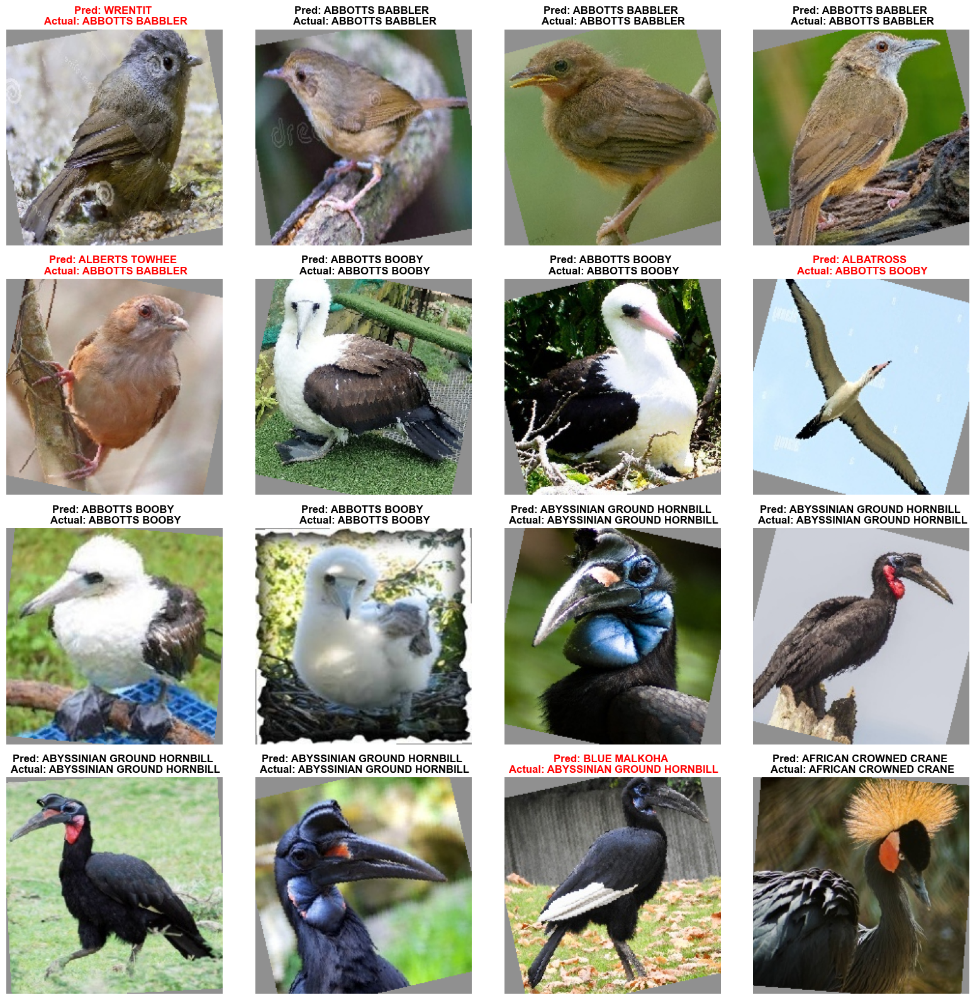

In [68]:
plot_random_samples_grid(valid_loader, effnet_optimized, LABELS)

#### Confusion Matrix

In [69]:
from torch.utils.data import ConcatDataset, DataLoader

# Join the validation and test datasets into a single dataset for evaluation
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Resize((224, 224)),
])

valid_dataset = CustomDataset(f'{data_path}/valid', transform)
test_dataset = CustomDataset(f'{data_path}/test', transform)

eval_dataset = ConcatDataset([valid_dataset, test_dataset])
eval_loader = DataLoader(eval_dataset, batch_size=32, shuffle=True)

original_predictions = predict_model(effnet, eval_loader, DEVICE)               # change to specific model
refined_predictions = predict_model(effnet_optimized, eval_loader, DEVICE)      # change to specific model

Making Prediction:   0%|          | 0/165 [00:00<?, ?it/s]

Making Prediction:   0%|          | 0/165 [00:00<?, ?it/s]

In [70]:
original_preds = torch.cat(original_predictions['preds'])
original_targets = torch.cat(original_predictions['targets'])

refined_preds = torch.cat(refined_predictions['preds'])
refined_targets = torch.cat(refined_predictions['targets'])

In [71]:
import torchmetrics, mlxtend
from torchmetrics import ConfusionMatrix
from mlxtend.plotting import plot_confusion_matrix

# 2. Setup confusion instance and compare predictions to targets
confmat = ConfusionMatrix(num_classes=CLASSES, task="multiclass")

original_cmat = confmat(original_preds, original_targets)
refined_cmat = confmat(refined_preds, refined_targets)

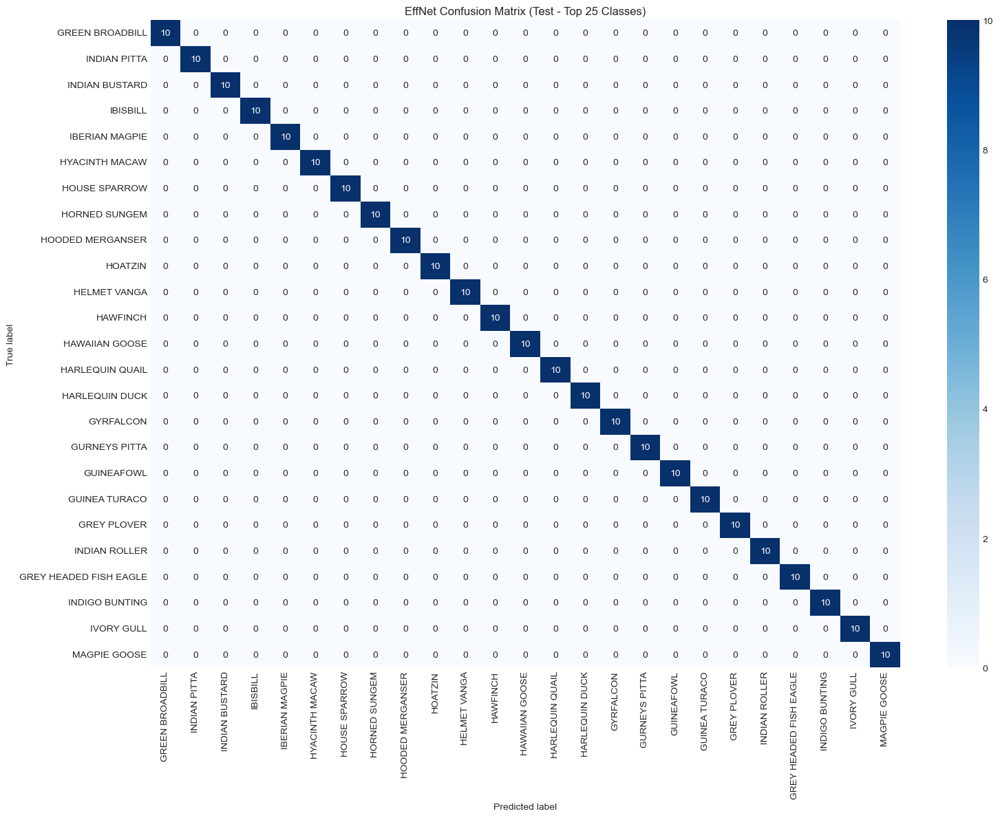

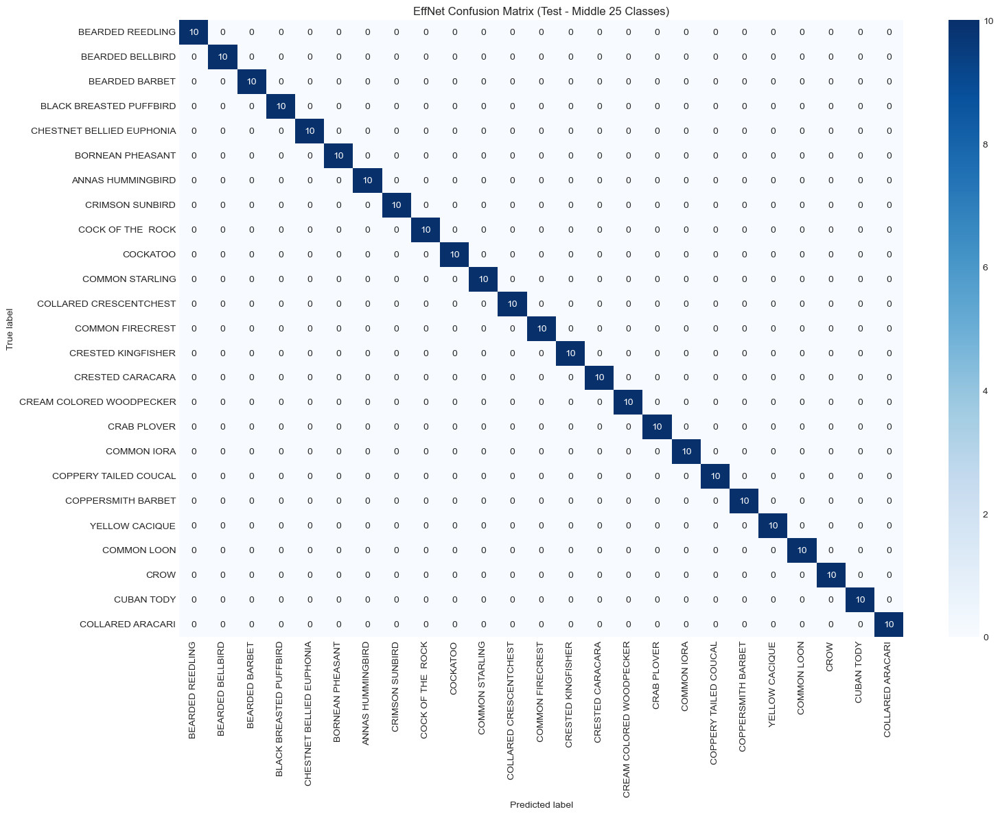

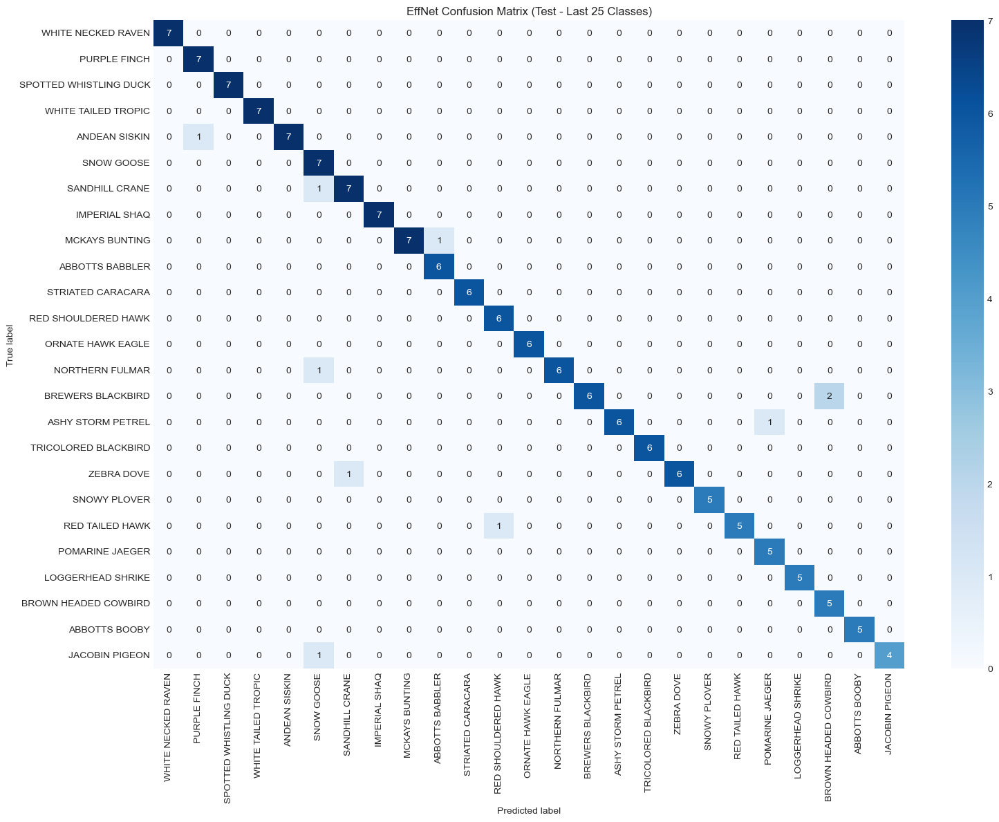

In [72]:
# Calculate the start and end indices for the middle 25 classesmid_count = 25
mid_start = (CLASSES - mid_count) // 2
mid_end = mid_start + mid_count
# Create a slice object for the middle 25 classes
middle_slice = slice(mid_start, mid_end)

# Example usage
plot_confusion_matrix_range(title="EffNet Confusion Matrix (Test - Top 25 Classes)", 
                            conf_mat=refined_cmat.numpy(), 
                            class_names=LABELS, 
                            range_slice=slice(0, 25))  # Top 25
plot_confusion_matrix_range(title="EffNet Confusion Matrix (Test - Middle 25 Classes)", 
                            conf_mat=refined_cmat.numpy(), 
                            class_names=LABELS, 
                            range_slice=middle_slice)  # Middle 25
plot_confusion_matrix_range(title="EffNet Confusion Matrix (Test - Last 25 Classes)", 
                            conf_mat=refined_cmat.numpy(), 
                            class_names=LABELS, 
                            range_slice=slice(-25, None))  # Top 25

#### Classification Report

In [73]:
from sklearn.metrics import classification_report

num_classes = CLASSES
target_names = ["Class {}".format(target) for i, target in enumerate(LABELS)]
print(classification_report(refined_targets, refined_preds, target_names=target_names))

                                     precision    recall  f1-score   support

              Class ABBOTTS BABBLER       0.86      0.60      0.71        10
                Class ABBOTTS BOOBY       0.83      0.50      0.62        10
   Class ABYSSINIAN GROUND HORNBILL       0.89      0.80      0.84        10
        Class AFRICAN CROWNED CRANE       1.00      1.00      1.00        10
       Class AFRICAN EMERALD CUCKOO       1.00      1.00      1.00        10
            Class AFRICAN FIREFINCH       0.83      1.00      0.91        10
       Class AFRICAN OYSTER CATCHER       1.00      1.00      1.00        10
        Class AFRICAN PIED HORNBILL       0.90      0.90      0.90        10
          Class AFRICAN PYGMY GOOSE       1.00      1.00      1.00        10
                    Class ALBATROSS       0.89      0.80      0.84        10
               Class ALBERTS TOWHEE       0.91      1.00      0.95        10
         Class ALEXANDRINE PARAKEET       0.90      0.90      0.90        1

In [74]:
from torchmetrics import MetricCollection
from torchmetrics.classification import MulticlassAccuracy, MulticlassPrecision, MulticlassRecall, MulticlassF1Score

model_name = "EffcientNet"  # change to specifc model name
metrics = MetricCollection([
            MulticlassAccuracy(CLASSES), 
            MulticlassPrecision(CLASSES), 
            MulticlassRecall(CLASSES),
            MulticlassF1Score(CLASSES)
        ])

original_result = metrics(original_preds, original_targets)
refined_result = metrics(refined_preds, refined_targets)
# Convert tensor values to Python scalars
original_result = {k: v.item() for k, v in original_result.items()}
refined_result = {k: v.item() for k, v in refined_result.items()}

# Create a DataFrame to compare the metrics
df = pd.DataFrame({
    'Metric': original_result.keys(),
    f'{model_name} Original': original_result.values(),
    f'{model_name} Optimized': refined_result.values()
})

df

,Metric,EffcientNet Original,EffcientNet Optimized
0,MulticlassAccuracy,0.918095,0.922857
1,MulticlassPrecision,0.925013,0.929492
2,MulticlassRecall,0.918095,0.922857
3,MulticlassF1Score,0.916936,0.921826


In [75]:
def compare_models(model1, model2, model1_name="trained_model", model2_name="refined_model"):
    results = []

    # Compare number of parameters
    params1 = sum(p.numel() for p in model1.parameters())
    params2 = sum(p.numel() for p in model2.parameters())
    results.append({
        'Comparison': 'Number of parameters',
        model1_name: params1,
        model2_name: params2,
        'Difference': params2 - params1
    })

    # Compare parameter values
    for (name1, param1), (name2, param2) in zip(model1.named_parameters(), model2.named_parameters()):
        if not torch.equal(param1, param2):
            diff = torch.abs(param1 - param2)
            results.append({
                'Comparison': f'Param: {name1} (Max diff)',
                model1_name: param1.max().item(),
                model2_name: param2.max().item(),
                'Difference': diff.max().item()
            })
            results.append({
                'Comparison': f'Param: {name1} (Mean diff)',
                model1_name: param1.mean().item(),
                model2_name: param2.mean().item(),
                'Difference': diff.mean().item()
            })
            results.append({
                'Comparison': f'Param: {name1} (Std diff)',
                model1_name: param1.std().item(),
                model2_name: param2.std().item(),
                'Difference': diff.std().item()
            })

    # Compare model outputs
    model1.eval()
    model2.eval()
    with torch.inference_mode():
        test_input = torch.randn(1, 3, 224, 224)  # Adjust input size as needed
        output1 = model1(test_input)
        output2 = model2(test_input)
        output_diff = torch.abs(output1 - output2)
        results.append({
            'Comparison': 'Model output (Max diff)',
            model1_name: output1.max().item(),
            model2_name: output2.max().item(),
            'Difference': output_diff.max().item()
        })
        results.append({
            'Comparison': 'Model output (Mean diff)',
            model1_name: output1.mean().item(),
            model2_name: output2.mean().item(),
            'Difference': output_diff.mean().item()
        })
        results.append({
            'Comparison': 'Model output (Std diff)',
            model1_name: output1.std().item(),
            model2_name: output2.std().item(),
            'Difference': output_diff.std().item()
        })

    # Create DataFrame
    df = pd.DataFrame(results)
    
    # Set 'Comparison' as index for better readability
    df.set_index('Comparison', inplace=True)
    
    return df

In [76]:
effnet = effnet.to("cpu")
effnet_optimized = effnet_optimized.to("cpu")
compare_models(effnet, effnet_optimized)

,trained_model,refined_model,Difference
Comparison,,,
Number of parameters,1.190765e+06,1.190765e+06,0.000000
Param: conv1.0.weight (Max diff),9.234203e+00,9.233605e+00,0.027675
Param: conv1.0.weight (Mean diff),-1.313524e-01,-1.310906e-01,0.004352
Param: conv1.0.weight (Std diff),1.624660e+00,1.624699e+00,0.005004
Param: conv1.1.weight (Max diff),6.803730e+00,6.805092e+00,0.045909
...,...,...,...
Param: fc.bias (Mean diff),-3.209829e-01,-3.209229e-01,0.007335
Param: fc.bias (Std diff),1.030962e+00,1.031174e+00,0.006183
Model output (Max diff),2.923376e+01,2.804006e+01,11.068790


## DenseNet

### Load model and functions

In [20]:
import os

import optuna
from optuna.trial import TrialState
from torchvision import datasets
from torchvision import transforms
from optuna.storages import RDBStorage

from helper_functions import train_model, eval_model

In [21]:
CLASSES = len(train_dataset.classes)
EPOCHS = 10
N_TRAIN_EXAMPLES = train_dataset.__len__() * 0.20
N_VALID_EXAMPLES = valid_dataset.__len__() * 0.20
N_TRAIN_EXAMPLES, N_VALID_EXAMPLES

(16927.0, 525.0)

In [ ]:
# Step 1: Define the Objective Function

def objective(trial):
    # Define hyperparameters to optimize
    batch_size = trial.suggest_categorical('batch_size', [8, 16, 32])
    optimizer_name = trial.suggest_categorical(
        "optimizer", ["Adam", "RMSprop", "SGD"])
    lr = trial.suggest_float("lr", 1e-5, 1e-1, log=True)

    # Early stopping parameters
    patience = trial.suggest_int('patience', 5, 20)
    min_delta = trial.suggest_float('min_delta', 1e-4, 1e-2, log=True)

    # Data loaders
    train_loader = DataLoader(
        train_dataset, batch_size=batch_size, shuffle=True)
    valid_loader = DataLoader(
        valid_dataset, batch_size=batch_size, shuffle=False)

    # Load model
    model = DenseNet(growth_rate=GROWTH_RATE, num_classes=CLASSES)
    model.load_state_dict(torch.load('models/densenet121_v1.pth'))
    model.to(DEVICE)

    optimizer = getattr(optim, optimizer_name)(model.parameters(), lr=lr)

    # Training loop with early stopping
    best_val_acc = 0
    epochs_no_improve = 0

    epoch_iterator = tqdm(range(
        1, EPOCHS + 1), desc=f"Trial {trial.number} | Epoch", unit="epoch", leave=False)
    for epoch in epoch_iterator:

        model.train()
        epoch_iterator.set_description(
            f"Trial {trial.number} | Train | Epoch {epoch}")

        for batch_idx, (inputs, labels) in enumerate(train_loader):
            # Limiting training data for faster epochs.
            if batch_idx * batch_size >= N_TRAIN_EXAMPLES:
                break

            inputs, labels = inputs.to(DEVICE), labels.to(DEVICE)
            optimizer.zero_grad()
            outputs = model(inputs)
            loss = F.cross_entropy(outputs, labels)
            loss.backward()
            optimizer.step()

        # Validation of the model.
        epoch_iterator.set_description(
            f"Trial {trial.number} | Valid | Epoch {epoch}")
        model.eval()
        correct = 0
        val_examples = 0
        with torch.inference_mode():
            for batch_idx, (inputs, labels) in enumerate(valid_loader):
                # Limiting validation data.
                if val_examples >= N_VALID_EXAMPLES:
                    break
                inputs, labels = inputs.to(DEVICE), labels.to(DEVICE)
                outputs = model(inputs)
                preds = outputs.argmax(dim=1, keepdim=True)
                correct += preds.eq(labels.view_as(preds)).sum().item()
                val_examples += inputs.size(0)

        accuracy = correct / min(len(valid_loader.dataset), N_VALID_EXAMPLES)
        trial.report(accuracy, epoch)

        # Handle pruning based on the intermediate value.
        if trial.should_prune():
            raise optuna.exceptions.TrialPruned()

        # Early stopping
        if accuracy > best_val_acc + min_delta:
            best_val_acc = accuracy
            epochs_no_improve = 0
        else:
            epochs_no_improve += 1

        if epochs_no_improve == patience:
            print(f"Early stopping triggered after epoch {epoch+1}")
            break

    return best_val_acc


study_name = "densenet-121_optimization"
storage = RDBStorage('sqlite:///db.sqlite3')
# Create a study object and specify the direction is 'maximize'.
study = optuna.create_study(
    study_name=study_name, storage=storage, direction='maximize', load_if_exists=True)

# Optimize
study.optimize(objective, n_trials=10)

pruned_trials = study.get_trials(deepcopy=False, states=[TrialState.PRUNED])
complete_trials = study.get_trials(
    deepcopy=False, states=[TrialState.COMPLETE])

print("Study statistics: ")
print("  Number of finished trials: ", len(study.trials))
print("  Number of pruned trials: ", len(pruned_trials))
print("  Number of complete trials: ", len(complete_trials))

# Print results
print('Best trial:')
trial = study.best_trial
print('Value: ', trial.value)
print('Params: ')
for key, value in trial.params.items():
    print('    {}: {}'.format(key, value))

### Refine model

In [ ]:
# model
densenet_v1_optimized = DenseNet(growth_rate=GROWTH_RATE, num_classes=CLASSES)
densenet_v1_optimized.load_state_dict(torch.load('models/densenet121_v1.pth'))
densenet_v1_optimized.to(DEVICE)

# data loaders
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=32, shuffle=False)
valid_loader = DataLoader(valid_dataset, batch_size=32, shuffle=True)

# best trial parameters
optimizer = optim.Adam(densenet_v1_optimized.parameters(),
                       lr=0.0003880818712273037)
patience = 12
min_delta = 0.0011221145234156418

# functions
criterion = nn.CrossEntropyLoss()
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=10, gamma=0.1)
accuracy_fn = Accuracy(task="multiclass", num_classes=CLASSES).to(DEVICE)

version_name = 'densenet121_optimized_v1'

# !!!! remember change the writer name to <model_name>_<version>
writer = SummaryWriter(f"runs/{version_name}")

/var/folders/66/4fld84796yv3g90zfcw891gw0000gn/T/ipykernel_26870/714130020.py:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  densenet_v1_optimized.load_state_dict(torch.lo

In [ ]:
from helper_functions import save_checkpoint

In [ ]:
result = {}
best_val_loss = float('inf')
best_epoch = 0
epochs_no_improve = 0
training_results = []
evaluation_results = []

for epoch in tqdm(range(1, 11), desc="Epochs", unit="epoch"):

    train_loss, train_acc = train_model(
        model=densenet_v1_optimized,
        data_loader=train_loader,
        loss_fn=criterion,
        optimizer=optimizer,
        accuracy_fn=accuracy_fn,
        device=DEVICE,
        epoch=epoch,
    )

    eval_loss, eval_acc = eval_model(
        model=densenet_v1_optimized,
        data_loader=test_loader,
        loss_fn=criterion,
        accuracy_fn=accuracy_fn,
        device=DEVICE,
        epoch=epoch,
    )

    scheduler.step()

    training_results.append(
        {"epoch": epoch, "loss": train_loss, "accuracy": train_acc})
    evaluation_results.append(
        {"epoch": epoch, "loss": eval_loss, "accuracy": eval_acc})

    writer.add_scalar('Loss/train', train_loss, epoch)
    writer.add_scalar('Loss/test', eval_loss, epoch)
    writer.add_scalar('Accuracy/train', train_acc, epoch)
    writer.add_scalar('Accuracy/test', eval_acc, epoch)

    if eval_loss < best_val_loss - min_delta:
        best_eval_loss = eval_loss
        epochs_no_improve = 0
    else:
        epochs_no_improve += 1

    # Early stopping
    if epochs_no_improve >= patience:
        print(f"Early stopping triggered. Best epoch: {best_epoch}")
        break

    result = {
        "train": training_results,
        "eval": evaluation_results
    }

    # save checkpoint
    save_checkpoint(model=densenet_v1_optimized,
                    optimizer=optimizer,
                    scheduler=scheduler,
                    history=result,
                    epoch=epoch,
                    model_name=version_name)

Epochs:   0%|          | 0/10 [00:00<?, ?epoch/s]

Epoch 1 | Training:   0%|          | 0/2645 [00:00<?, ?batch/s]

Epoch 1 | Evaluating:   0%|          | 0/83 [00:00<?, ?batch/s]

Epoch 2 | Training:   0%|          | 0/2645 [00:00<?, ?batch/s]

Epoch 2 | Evaluating:   0%|          | 0/83 [00:00<?, ?batch/s]

Epoch 3 | Training:   0%|          | 0/2645 [00:00<?, ?batch/s]

Epoch 3 | Evaluating:   0%|          | 0/83 [00:00<?, ?batch/s]

Epoch 4 | Training:   0%|          | 0/2645 [00:00<?, ?batch/s]

Epoch 4 | Evaluating:   0%|          | 0/83 [00:00<?, ?batch/s]

Epoch 5 | Training:   0%|          | 0/2645 [00:00<?, ?batch/s]

Epoch 5 | Evaluating:   0%|          | 0/83 [00:00<?, ?batch/s]

Epoch 6 | Training:   0%|          | 0/2645 [00:00<?, ?batch/s]

Epoch 6 | Evaluating:   0%|          | 0/83 [00:00<?, ?batch/s]

Epoch 7 | Training:   0%|          | 0/2645 [00:00<?, ?batch/s]

Epoch 7 | Evaluating:   0%|          | 0/83 [00:00<?, ?batch/s]

Epoch 8 | Training:   0%|          | 0/2645 [00:00<?, ?batch/s]

Epoch 8 | Evaluating:   0%|          | 0/83 [00:00<?, ?batch/s]

Epoch 9 | Training:   0%|          | 0/2645 [00:00<?, ?batch/s]

Epoch 9 | Evaluating:   0%|          | 0/83 [00:00<?, ?batch/s]

Epoch 10 | Training:   0%|          | 0/2645 [00:00<?, ?batch/s]

Epoch 10 | Evaluating:   0%|          | 0/83 [00:00<?, ?batch/s]

### Save Model

In [ ]:
# save the model
save_model(densenet_v1_optimized, version_name)

PosixPath('models/densenet121_optimized_v1.pth')

In [ ]:
# Create DataFrames for train and eval data
train_df = pd.DataFrame(result['train'])
eval_df = pd.DataFrame(result['eval'])

# Add a column to distinguish between train and eval data
train_df['set'] = 'train'
eval_df['set'] = 'eval'

# Combine the two DataFrames
history_df = pd.concat([train_df, eval_df], ignore_index=True)
history_df

,epoch,loss,accuracy,set
0,1,0.535268,0.862387,train
1,2,0.478378,0.877475,train
2,3,0.454983,0.884355,train
3,4,0.440270,0.886151,train
4,5,0.430281,0.889122,train
5,6,0.419875,0.891773,train
6,7,0.411920,0.892524,train
7,8,0.406846,0.894535,train
8,9,0.399294,0.895567,train
9,10,0.391414,0.897335,train


In [ ]:
# save the history to a csv file
save_history(history_df, version_name)

### Evalution

In [48]:
# load the original model
densenet = DenseNet(growth_rate=GROWTH_RATE, num_classes=CLASSES)
densenet.load_state_dict(torch.load('models/densenet121_v1.pth'))
densenet.to(DEVICE)

/var/folders/md/rch60bjd0sz1jyk0vg1yh33c0000gn/T/ipykernel_32941/3030817477.py:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  densenet.load_state_dict(torch.load('models/d

DenseNet(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (denseblock1): DenseBlock(
      (layers): ModuleList(
        (0): DenseLayer(
          (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (conv2): Conv2d(64, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        )
        (1): DenseLayer(
          (bn1): BatchNorm2d(80, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (conv1): Conv2d(80, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        

In [50]:
# load the model
densenet_optimized = DenseNet(growth_rate=GROWTH_RATE, num_classes=CLASSES)                  # change to specific model                        # change to specific model
densenet_optimized.load_state_dict(torch.load(f'models/densenet121_optimized_v1.pth'))     # change to specific model
densenet_optimized.to(DEVICE)

/var/folders/md/rch60bjd0sz1jyk0vg1yh33c0000gn/T/ipykernel_32941/4122255050.py:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  densenet_optimized.load_state_dict(torch.load

DenseNet(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (denseblock1): DenseBlock(
      (layers): ModuleList(
        (0): DenseLayer(
          (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (conv2): Conv2d(64, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        )
        (1): DenseLayer(
          (bn1): BatchNorm2d(80, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (conv1): Conv2d(80, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        

#### Visualize

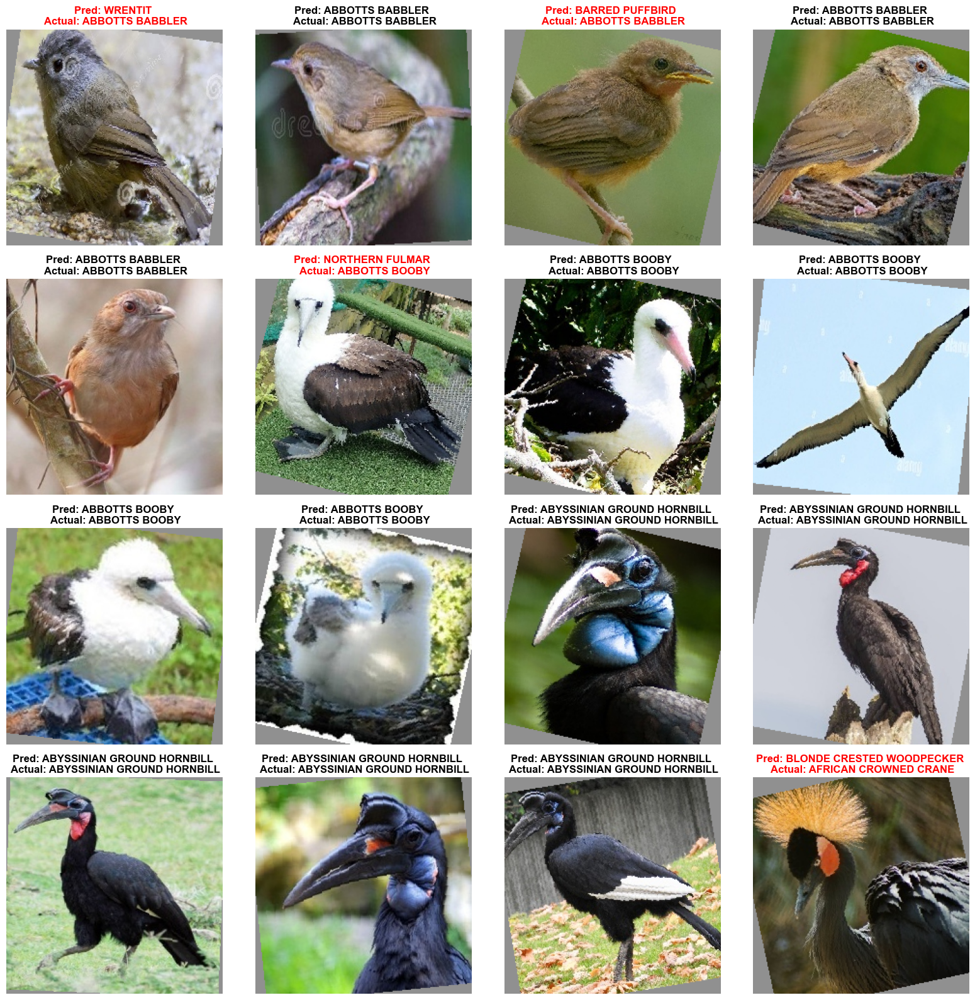

In [51]:
plot_random_samples_grid(valid_loader, densenet_optimized, LABELS)

#### Confusion Matrix

In [52]:
from torch.utils.data import ConcatDataset, DataLoader

# Join the validation and test datasets into a single dataset for evaluation
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Resize((224, 224)),
])

valid_dataset = CustomDataset(f'{data_path}/valid', transform)
test_dataset = CustomDataset(f'{data_path}/test', transform)

eval_dataset = ConcatDataset([valid_dataset, test_dataset])
eval_loader = DataLoader(eval_dataset, batch_size=32, shuffle=True)

original_predictions = predict_model(densenet, eval_loader, DEVICE)               # change to specific model
refined_predictions = predict_model(densenet_optimized, eval_loader, DEVICE)      # change to specific model

Making Prediction:   0%|          | 0/165 [00:00<?, ?it/s]

Making Prediction:   0%|          | 0/165 [00:00<?, ?it/s]

In [54]:
original_preds = torch.cat(original_predictions['preds'])
original_targets = torch.cat(original_predictions['targets'])

refined_preds = torch.cat(refined_predictions['preds'])
refined_targets = torch.cat(refined_predictions['targets'])

In [55]:
import torchmetrics, mlxtend
from torchmetrics import ConfusionMatrix
from mlxtend.plotting import plot_confusion_matrix

# 2. Setup confusion instance and compare predictions to targets
confmat = ConfusionMatrix(num_classes=CLASSES, task="multiclass")

original_cmat = confmat(original_preds, original_targets)
refined_cmat = confmat(refined_preds, refined_targets)

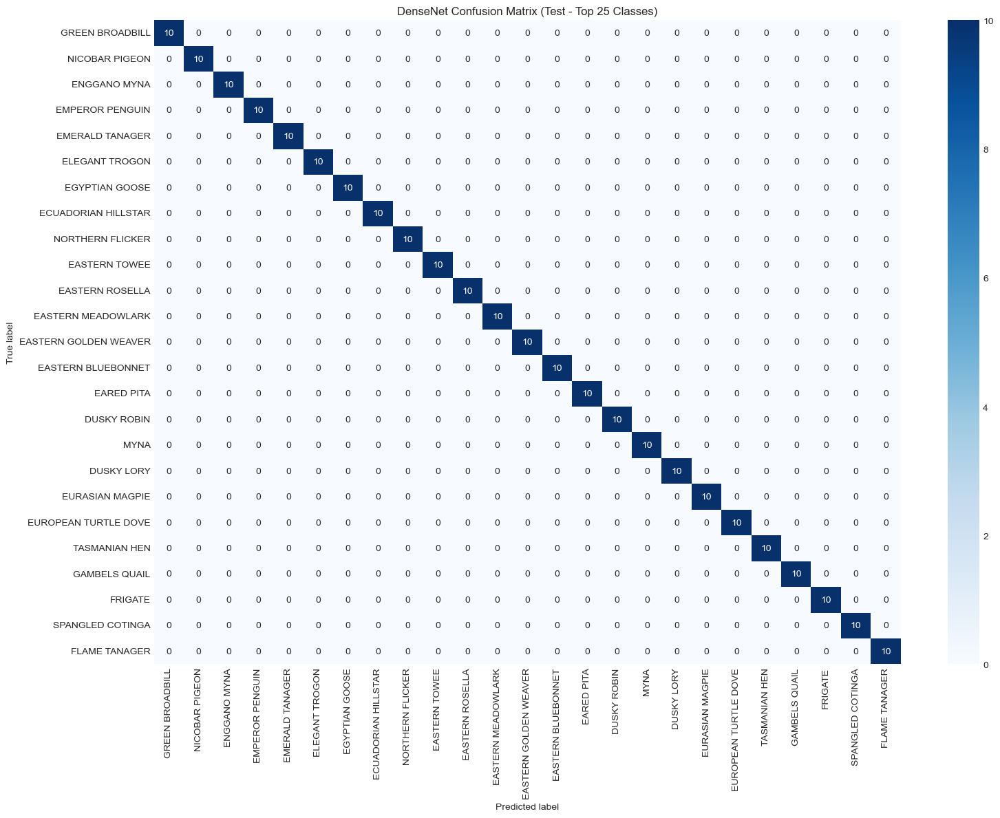

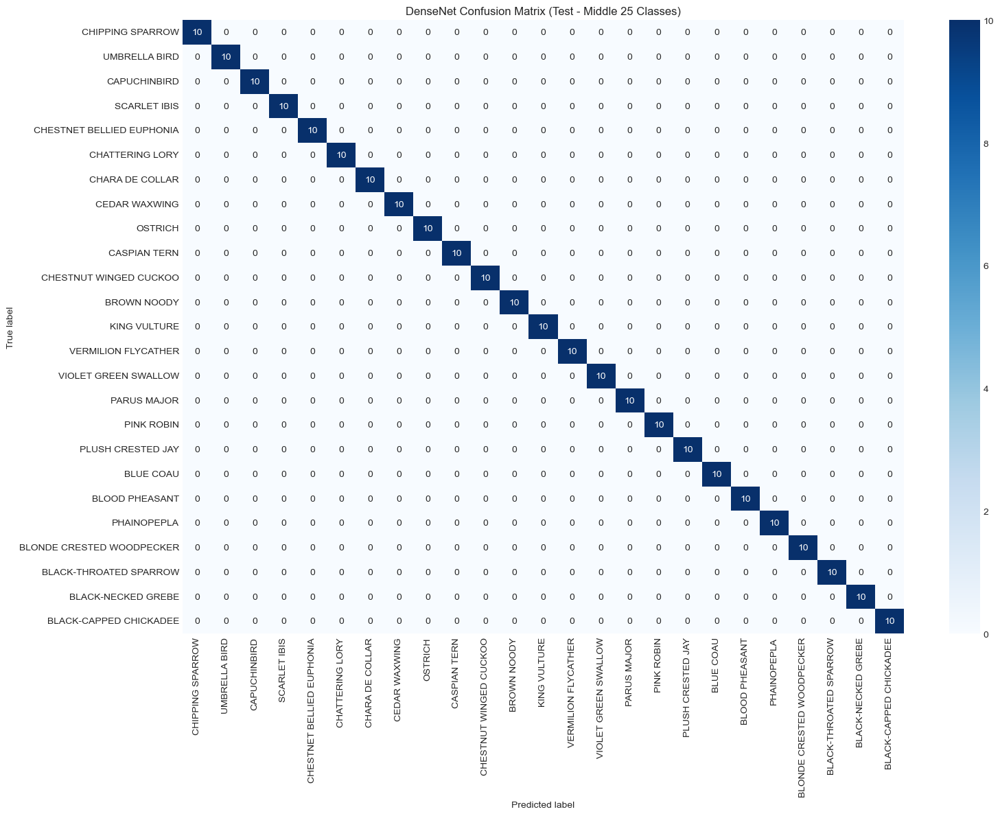

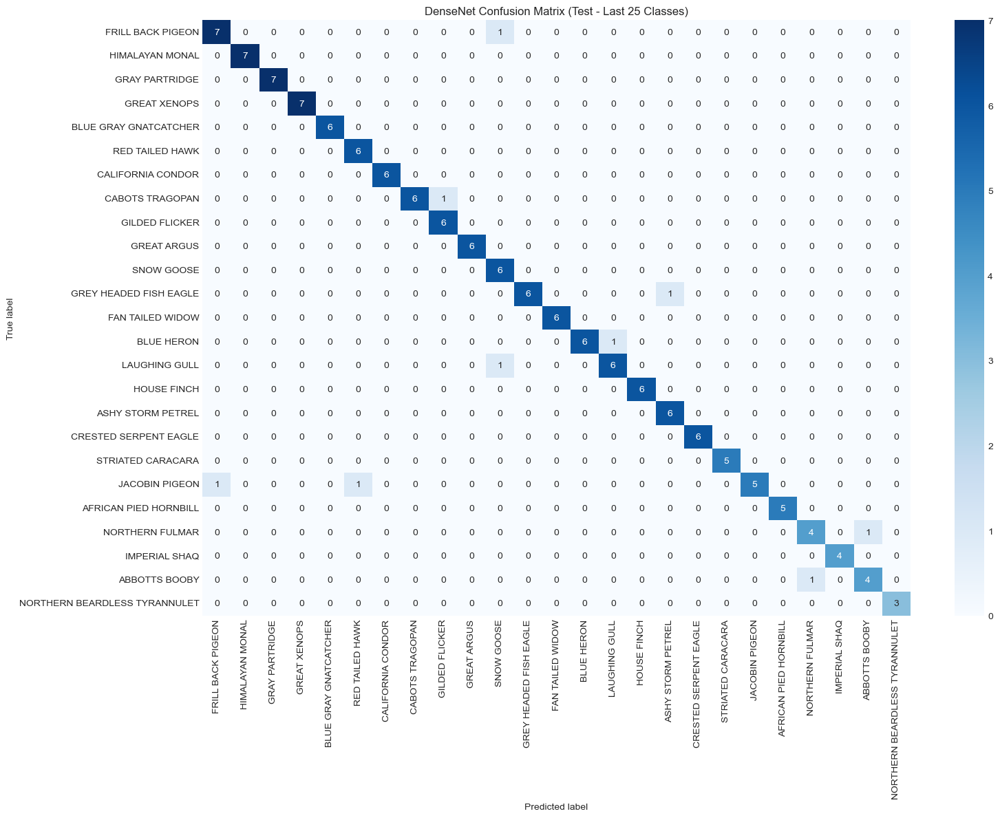

In [56]:
# Calculate the start and end indices for the middle 25 classes
model_name = "DenseNet"
mid_count = 25
mid_start = (CLASSES - mid_count) // 2
mid_end = mid_start + mid_count
# Create a slice object for the middle 25 classes
middle_slice = slice(mid_start, mid_end)

# Example usage
plot_confusion_matrix_range(title=f"{model_name} Confusion Matrix (Test - Top 25 Classes)", 
                            conf_mat=refined_cmat.numpy(), 
                            class_names=LABELS, 
                            range_slice=slice(0, 25))  # Top 25
plot_confusion_matrix_range(title=f"{model_name} Confusion Matrix (Test - Middle 25 Classes)", 
                            conf_mat=refined_cmat.numpy(), 
                            class_names=LABELS, 
                            range_slice=middle_slice)  # Middle 25
plot_confusion_matrix_range(title=f"{model_name} Confusion Matrix (Test - Last 25 Classes)", 
                            conf_mat=refined_cmat.numpy(), 
                            class_names=LABELS, 
                            range_slice=slice(-25, None))  # Top 25

#### Classification Report

In [57]:
from sklearn.metrics import classification_report

num_classes = CLASSES
target_names = ["Class {}".format(target) for i, target in enumerate(LABELS)]
print(classification_report(refined_targets, refined_preds, target_names=target_names))

                                     precision    recall  f1-score   support

              Class ABBOTTS BABBLER       0.89      0.80      0.84        10
                Class ABBOTTS BOOBY       0.67      0.40      0.50        10
   Class ABYSSINIAN GROUND HORNBILL       0.90      0.90      0.90        10
        Class AFRICAN CROWNED CRANE       1.00      0.80      0.89        10
       Class AFRICAN EMERALD CUCKOO       1.00      0.90      0.95        10
            Class AFRICAN FIREFINCH       1.00      1.00      1.00        10
       Class AFRICAN OYSTER CATCHER       0.91      1.00      0.95        10
        Class AFRICAN PIED HORNBILL       1.00      0.50      0.67        10
          Class AFRICAN PYGMY GOOSE       1.00      1.00      1.00        10
                    Class ALBATROSS       0.64      0.90      0.75        10
               Class ALBERTS TOWHEE       1.00      1.00      1.00        10
         Class ALEXANDRINE PARAKEET       1.00      1.00      1.00        1

In [58]:
model_name = "DenseNet"  # change to specifc model name
metrics = MetricCollection([
            MulticlassAccuracy(CLASSES), 
            MulticlassPrecision(CLASSES), 
            MulticlassRecall(CLASSES),
            MulticlassF1Score(CLASSES)
        ])

original_result = metrics(original_preds, original_targets)
refined_result = metrics(refined_preds, refined_targets)
# Convert tensor values to Python scalars
original_result = {k: v.item() for k, v in original_result.items()}
refined_result = {k: v.item() for k, v in refined_result.items()}

# Create a DataFrame to compare the metrics
df = pd.DataFrame({
    'Metric': original_result.keys(),
    f'{model_name} Original': original_result.values(),
    f'{model_name} Optimized': refined_result.values()
})

df

,Metric,DenseNet Original,DenseNet Optimized
0,MulticlassAccuracy,0.872381,0.918857
1,MulticlassPrecision,0.889836,0.925623
2,MulticlassRecall,0.872381,0.918857
3,MulticlassF1Score,0.870967,0.917715


# ResNet

### Load model and functions

In [ ]:
import os

import optuna
from optuna.trial import TrialState
from torchvision import datasets
from torchvision import transforms
from optuna.storages import RDBStorage

from helper_functions import train_model, eval_model

In [ ]:
CLASSES = len(train_dataset.classes)
EPOCHS = 10
N_TRAIN_EXAMPLES = train_dataset.__len__() * 0.20
N_VALID_EXAMPLES = valid_dataset.__len__() * 0.20
N_TRAIN_EXAMPLES, N_VALID_EXAMPLES

(16927.0, 525.0)

In [ ]:
# Step 1: Define the Objective Function

def objective(trial):
    # Define hyperparameters to optimize
    batch_size = trial.suggest_categorical('batch_size', [8, 16, 32])
    optimizer_name = trial.suggest_categorical("optimizer", ["Adam", "RMSprop", "SGD"])
    lr = trial.suggest_float("lr", 1e-5, 1e-1, log=True)
    
    # Early stopping parameters
    patience = trial.suggest_int('patience', 5, 20)
    min_delta = trial.suggest_float('min_delta', 1e-4, 1e-2, log=True)

    # Data loaders
    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
    valid_loader = DataLoader(valid_dataset, batch_size=batch_size, shuffle=False)

    # Load model
    model = ResNet34(num_classes=CLASSES)
    model.load_state_dict(torch.load('models/resnet_v1.pth'))
    model.to(DEVICE)

    optimizer = getattr(optim, optimizer_name)(model.parameters(), lr=lr)

    # Training loop with early stopping
    best_val_acc = 0
    epochs_no_improve = 0
    
    epoch_iterator = tqdm(range(1, EPOCHS + 1), desc=f"Trial {trial.number} | Epoch", unit="epoch", leave=False)
    for epoch in epoch_iterator:
        
        model.train()
        epoch_iterator.set_description(f"Trial {trial.number} | Train | Epoch {epoch}")
        
        for batch_idx, (inputs, labels) in enumerate(train_loader):
            # Limiting training data for faster epochs.
            if batch_idx * batch_size >= N_TRAIN_EXAMPLES:
                break
            
            inputs, labels = inputs.to(DEVICE), labels.to(DEVICE)
            optimizer.zero_grad()
            outputs = model(inputs)
            loss = F.cross_entropy(outputs, labels)
            loss.backward()
            optimizer.step()

        # Validation of the model.
        epoch_iterator.set_description(f"Trial {trial.number} | Valid | Epoch {epoch}")
        model.eval()
        correct = 0
        val_examples = 0
        with torch.inference_mode():
            for batch_idx, (inputs, labels) in enumerate(valid_loader):
                # Limiting validation data.
                if val_examples >= N_VALID_EXAMPLES:
                    break
                inputs, labels = inputs.to(DEVICE), labels.to(DEVICE)
                outputs = model(inputs)
                preds = outputs.argmax(dim=1, keepdim=True)
                correct += preds.eq(labels.view_as(preds)).sum().item()
                val_examples += inputs.size(0)

        accuracy = correct / min(len(valid_loader.dataset), N_VALID_EXAMPLES)
        trial.report(accuracy, epoch)

        # Handle pruning based on the intermediate value.
        if trial.should_prune():
            raise optuna.exceptions.TrialPruned()
        
        # Early stopping
        if accuracy > best_val_acc + min_delta:
            best_val_acc = accuracy
            epochs_no_improve = 0
        else:
            epochs_no_improve += 1
        
        if epochs_no_improve == patience:
            print(f"Early stopping triggered after epoch {epoch+1}")
            break

    return best_val_acc


study_name = "resnet_optimization"
storage = RDBStorage('sqlite:///db.sqlite3')
# Create a study object and specify the direction is 'maximize'.
study = optuna.create_study(study_name=study_name, storage=storage, direction='maximize', load_if_exists=True)

# Optimize
study.optimize(objective, n_trials=10)

pruned_trials = study.get_trials(deepcopy=False, states=[TrialState.PRUNED])
complete_trials = study.get_trials(deepcopy=False, states=[TrialState.COMPLETE])

print("Study statistics: ")
print("  Number of finished trials: ", len(study.trials))
print("  Number of pruned trials: ", len(pruned_trials))
print("  Number of complete trials: ", len(complete_trials))

# Print results
print('Best trial:')
trial = study.best_trial
print('Value: ', trial.value)
print('Params: ')
for key, value in trial.params.items():
    print('    {}: {}'.format(key, value))
    

[I 2024-08-14 23:22:38,559] A new study created in RDB with name: resnet_optimization
C:\Users\SHUAIGEE\AppData\Local\Temp\ipykernel_26280\1098060543.py:19: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to

Trial 0 | Epoch:   0%|          | 0/10 [00:00<?, ?epoch/s]

[I 2024-08-14 23:49:20,057] Trial 0 finished with value: 0.9276190476190476 and parameters: {'batch_size': 8, 'optimizer': 'Adam', 'lr': 0.0012565242133990644, 'patience': 17, 'min_delta': 0.0017433986914210434}. Best is trial 0 with value: 0.9276190476190476.


Trial 1 | Epoch:   0%|          | 0/10 [00:00<?, ?epoch/s]

[I 2024-08-15 00:14:19,205] Trial 1 finished with value: 0.8495238095238096 and parameters: {'batch_size': 8, 'optimizer': 'RMSprop', 'lr': 0.008601055100186203, 'patience': 7, 'min_delta': 0.00010859303281590074}. Best is trial 0 with value: 0.9276190476190476.


Early stopping triggered after epoch 11


Trial 2 | Epoch:   0%|          | 0/10 [00:00<?, ?epoch/s]

[I 2024-08-15 00:32:36,223] Trial 2 finished with value: 0.9333333333333333 and parameters: {'batch_size': 32, 'optimizer': 'Adam', 'lr': 2.77945988032835e-05, 'patience': 14, 'min_delta': 0.0019711541168110974}. Best is trial 2 with value: 0.9333333333333333.


Trial 3 | Epoch:   0%|          | 0/10 [00:00<?, ?epoch/s]

[I 2024-08-15 00:52:24,368] Trial 3 finished with value: 0.9257142857142857 and parameters: {'batch_size': 16, 'optimizer': 'Adam', 'lr': 0.0006006753066945991, 'patience': 13, 'min_delta': 0.00151628680934896}. Best is trial 2 with value: 0.9333333333333333.


Trial 4 | Epoch:   0%|          | 0/10 [00:00<?, ?epoch/s]

[I 2024-08-15 01:08:35,255] Trial 4 finished with value: 0.8838095238095238 and parameters: {'batch_size': 8, 'optimizer': 'SGD', 'lr': 0.00031846470286607114, 'patience': 7, 'min_delta': 0.004359615009209739}. Best is trial 2 with value: 0.9333333333333333.


Early stopping triggered after epoch 9


Trial 5 | Epoch:   0%|          | 0/10 [00:00<?, ?epoch/s]

[I 2024-08-15 01:10:31,915] Trial 5 pruned. 


Trial 6 | Epoch:   0%|          | 0/10 [00:00<?, ?epoch/s]

[I 2024-08-15 01:12:27,775] Trial 6 pruned. 


Trial 7 | Epoch:   0%|          | 0/10 [00:00<?, ?epoch/s]

[I 2024-08-15 01:14:23,553] Trial 7 pruned. 


Trial 8 | Epoch:   0%|          | 0/10 [00:00<?, ?epoch/s]

[I 2024-08-15 01:28:29,654] Trial 8 pruned. 


Trial 9 | Epoch:   0%|          | 0/10 [00:00<?, ?epoch/s]

[I 2024-08-15 01:43:53,954] Trial 9 pruned. 


Study statistics: 
  Number of finished trials:  10
  Number of pruned trials:  5
  Number of complete trials:  5
Best trial:
Value:  0.9333333333333333
Params: 
    batch_size: 32
    optimizer: Adam
    lr: 2.77945988032835e-05
    patience: 14
    min_delta: 0.0019711541168110974


### Refine model

In [ ]:
# model
model = ResNet34(num_classes=CLASSES)
model.load_state_dict(torch.load('models/resnet_v1.pth'))
model.to(DEVICE)

# data loaders
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=32, shuffle=False)
valid_loader = DataLoader(valid_dataset, batch_size=32, shuffle=True)

# best trial parameters
optimizer = optim.Adam(model.parameters(), lr=2.77945988032835e-05)
patience = 14
min_delta = 0.0019711541168110974

# functions
criterion = nn.CrossEntropyLoss()
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=10, gamma=0.1)
accuracy_fn = Accuracy(task="multiclass", num_classes=CLASSES).to(DEVICE)

version_name = 'resnet_optimized_v1'

# !!!! remember change the writer name to <model_name>_<version>
writer = SummaryWriter('runs/{version_name}')

C:\Users\SHUAIGEE\AppData\Local\Temp\ipykernel_26280\23598449.py:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load('models/resnet_v1.pth'))


In [ ]:
from helper_functions import save_checkpoint

In [ ]:
result = {}
best_val_loss = float('inf')
best_epoch = 0
epochs_no_improve = 0
training_results = []
evaluation_results = []

for epoch in tqdm(range(1, 11), desc="Epochs", unit="epoch"):
    
    train_loss, train_acc = train_model(
        model=model,
        data_loader=train_loader,
        loss_fn=criterion,
        optimizer=optimizer,
        accuracy_fn=accuracy_fn,
        device=DEVICE,
        epoch=epoch,
    )
    
    eval_loss, eval_acc = eval_model(
        model=model,
        data_loader=test_loader,
        loss_fn=criterion,
        accuracy_fn=accuracy_fn,
        device=DEVICE,
        epoch=epoch,
    )
    
    scheduler.step()
    
    training_results.append({"epoch": epoch, "loss": train_loss, "accuracy": train_acc})
    evaluation_results.append({"epoch": epoch, "loss": eval_loss, "accuracy": eval_acc})
    
    writer.add_scalar('Loss/train', train_loss, epoch)
    writer.add_scalar('Loss/test', eval_loss, epoch)
    writer.add_scalar('Accuracy/train', train_acc, epoch)
    writer.add_scalar('Accuracy/test', eval_acc, epoch)
    
    if eval_loss < best_val_loss - min_delta:
        best_eval_loss = eval_loss
        epochs_no_improve = 0
    else:
        epochs_no_improve += 1
        
    # Early stopping
    if epochs_no_improve >= patience:
        print(f"Early stopping triggered. Best epoch: {best_epoch}")
        break
        
    
    result = {
        "train": training_results,
        "eval": evaluation_results
    }
    
    # save checkpoint
    save_checkpoint(model=model, 
                    optimizer=optimizer, 
                    scheduler=scheduler, 
                    history=result, 
                    epoch=epoch,
                    model_name=version_name)

Epochs:   0%|          | 0/10 [00:00<?, ?epoch/s]

Epoch 1 | Training:   0%|          | 0/2645 [00:00<?, ?batch/s]

Epoch 1 | Evaluating:   0%|          | 0/83 [00:00<?, ?batch/s]

Epoch 2 | Training:   0%|          | 0/2645 [00:00<?, ?batch/s]

Epoch 2 | Evaluating:   0%|          | 0/83 [00:00<?, ?batch/s]

Epoch 3 | Training:   0%|          | 0/2645 [00:00<?, ?batch/s]

Epoch 3 | Evaluating:   0%|          | 0/83 [00:00<?, ?batch/s]

Epoch 4 | Training:   0%|          | 0/2645 [00:00<?, ?batch/s]

Epoch 4 | Evaluating:   0%|          | 0/83 [00:00<?, ?batch/s]

Epoch 5 | Training:   0%|          | 0/2645 [00:00<?, ?batch/s]

Epoch 5 | Evaluating:   0%|          | 0/83 [00:00<?, ?batch/s]

Epoch 6 | Training:   0%|          | 0/2645 [00:00<?, ?batch/s]

Epoch 6 | Evaluating:   0%|          | 0/83 [00:00<?, ?batch/s]

Epoch 7 | Training:   0%|          | 0/2645 [00:00<?, ?batch/s]

Epoch 7 | Evaluating:   0%|          | 0/83 [00:00<?, ?batch/s]

Epoch 8 | Training:   0%|          | 0/2645 [00:00<?, ?batch/s]

Epoch 8 | Evaluating:   0%|          | 0/83 [00:00<?, ?batch/s]

Epoch 9 | Training:   0%|          | 0/2645 [00:00<?, ?batch/s]

Epoch 9 | Evaluating:   0%|          | 0/83 [00:00<?, ?batch/s]

Epoch 10 | Training:   0%|          | 0/2645 [00:00<?, ?batch/s]

Epoch 10 | Evaluating:   0%|          | 0/83 [00:00<?, ?batch/s]

### Save Model

In [ ]:
# save the model
save_model(model, version_name)

WindowsPath('models/resnet_optimized_v1.pth')

In [ ]:
# Create DataFrames for train and eval data
train_df = pd.DataFrame(result['train'])
eval_df = pd.DataFrame(result['eval'])

# Add a column to distinguish between train and eval data
train_df['set'] = 'train'
eval_df['set'] = 'eval'

# Combine the two DataFrames
history_df = pd.concat([train_df, eval_df], ignore_index=True)
history_df

,epoch,loss,accuracy,set
0,1,0.343232,0.904875,train
1,2,0.294578,0.919119,train
2,3,0.270184,0.925053,train
3,4,0.252023,0.930730,train
4,5,0.238072,0.934577,train
5,6,0.229347,0.937484,train
6,7,0.222979,0.938843,train
7,8,0.215112,0.942139,train
8,9,0.207284,0.943384,train
9,10,0.203871,0.944665,train


In [ ]:
# save the history to a csv file
save_history(history_df, version_name)

### Evalution

In [91]:
# load the original model
resnet = ResNet34(num_classes=CLASSES)
resnet.load_state_dict(torch.load('models/resnet_v1.pth', map_location=DEVICE))  # Map to the correct device
resnet.to(DEVICE)

/var/folders/md/rch60bjd0sz1jyk0vg1yh33c0000gn/T/ipykernel_32941/3746263970.py:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  resnet.load_state_dict(torch.load('models/res

ResNet34(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, ker

In [93]:
# load the model
resnet_optimized = ResNet34(num_classes=CLASSES)
resnet_optimized.load_state_dict(torch.load('models/resnet_re-optimized_v1.pth', map_location=DEVICE))  # Map to the correct device
resnet_optimized.to(DEVICE)

/var/folders/md/rch60bjd0sz1jyk0vg1yh33c0000gn/T/ipykernel_32941/3413366436.py:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  resnet_optimized.load_state_dict(torch.load('

ResNet34(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, ker

#### Visualize

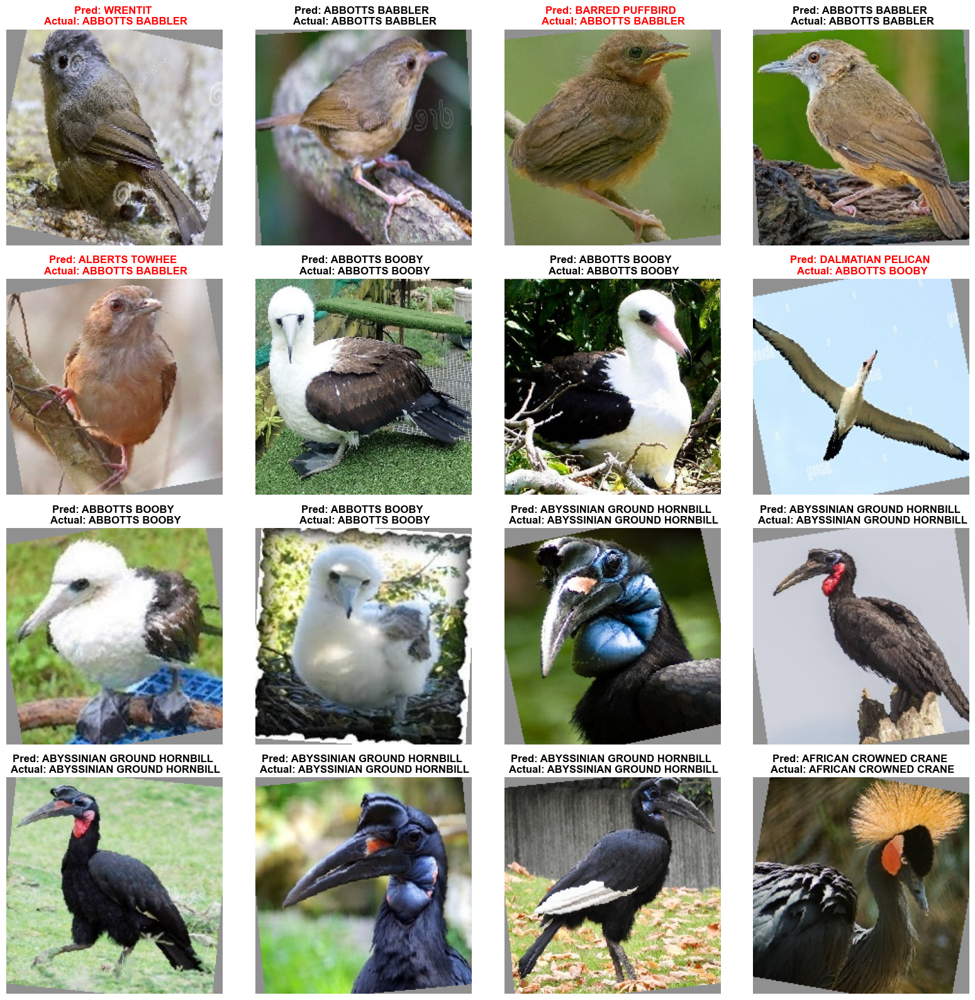

In [94]:
plot_random_samples_grid(valid_loader, resnet_optimized, LABELS)

#### Confusion Matrix

In [95]:
from torch.utils.data import ConcatDataset, DataLoader

# Join the validation and test datasets into a single dataset for evaluation
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Resize((224, 224)),
])

valid_dataset = CustomDataset(f'{data_path}/valid', transform)
test_dataset = CustomDataset(f'{data_path}/test', transform)

eval_dataset = ConcatDataset([valid_dataset, test_dataset])
eval_loader = DataLoader(eval_dataset, batch_size=32, shuffle=True)

original_predictions = predict_model(resnet, eval_loader, DEVICE)               # change to specific model
refined_predictions = predict_model(resnet_optimized, eval_loader, DEVICE)      # change to specific model

Making Prediction:   0%|          | 0/165 [00:00<?, ?it/s]

Making Prediction:   0%|          | 0/165 [00:00<?, ?it/s]

In [103]:
original_preds = torch.cat(original_predictions['preds'])
original_targets = torch.cat(original_predictions['targets'])

refined_preds = torch.cat(refined_predictions['preds'])
refined_targets = torch.cat(refined_predictions['targets'])

In [105]:
import torchmetrics, mlxtend
from torchmetrics import ConfusionMatrix
from mlxtend.plotting import plot_confusion_matrix

# 2. Setup confusion instance and compare predictions to targets
confmat = ConfusionMatrix(num_classes=CLASSES, task="multiclass")

original_cmat = confmat(original_preds, original_targets)
refined_cmat = confmat(refined_preds, refined_targets)

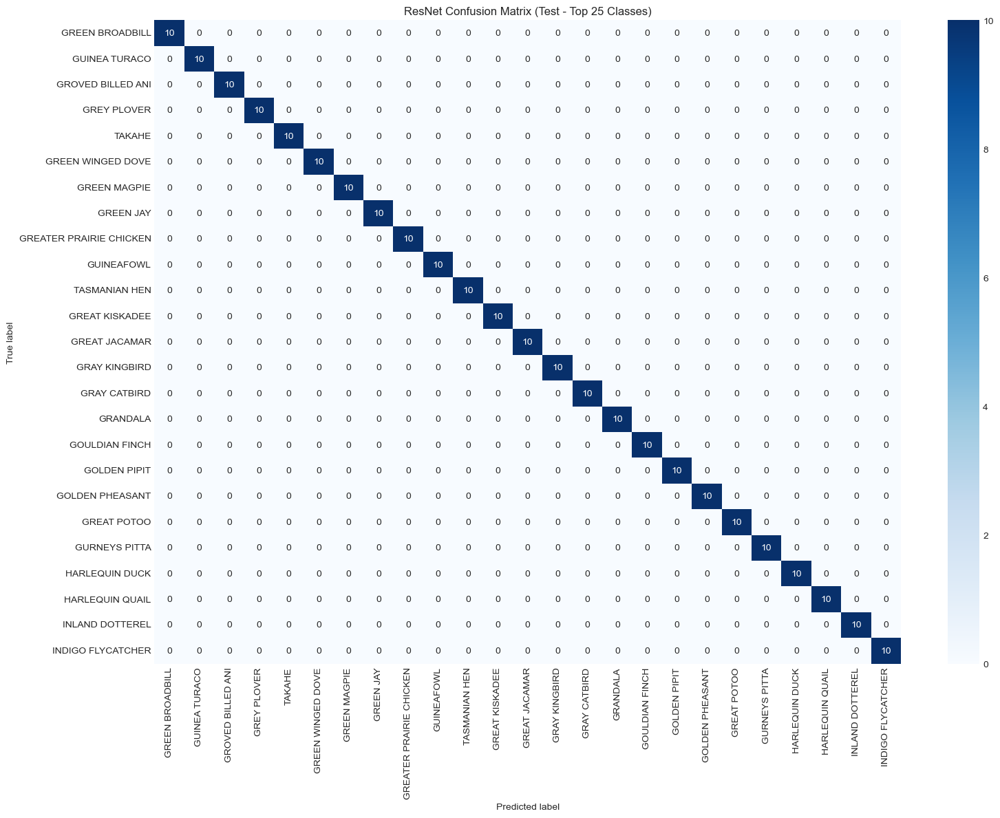

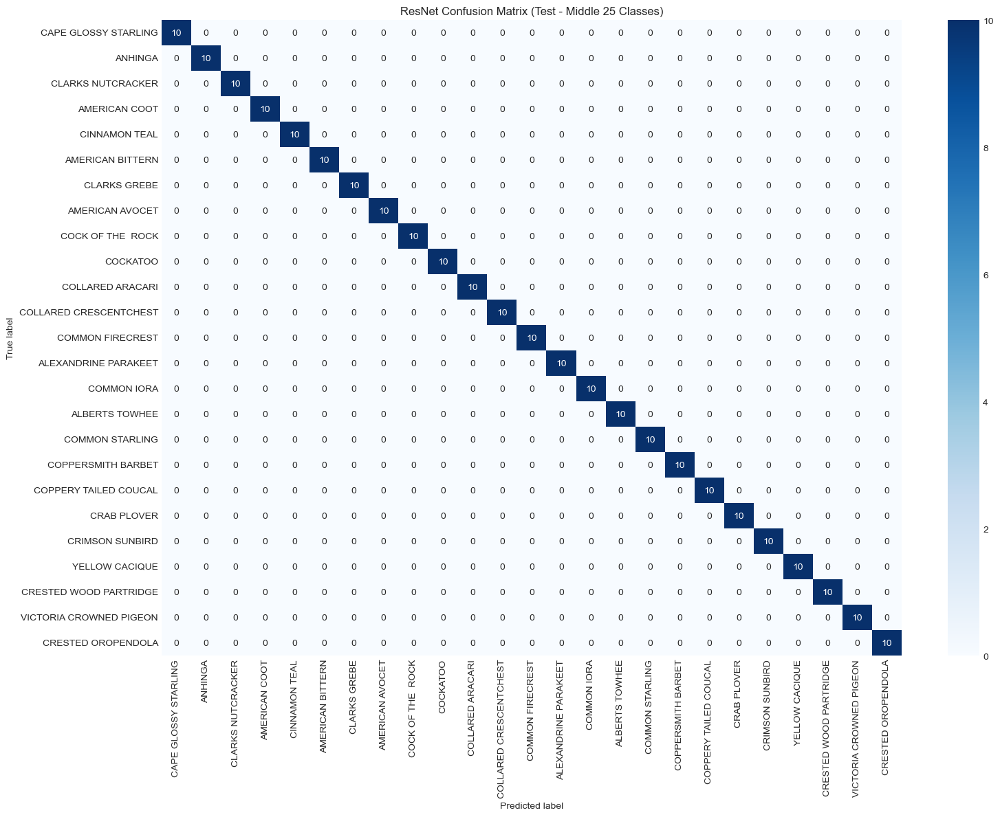

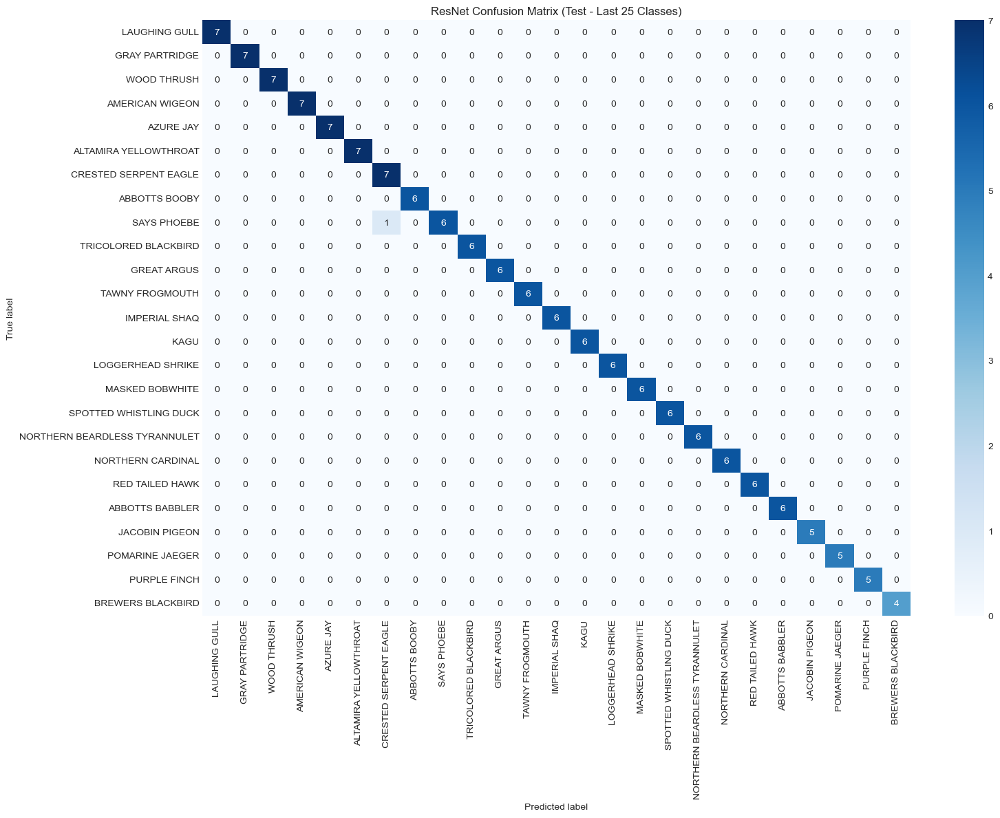

In [106]:
# Calculate the start and end indices for the middle 25 classes
model_name = "ResNet"
mid_count = 25
mid_start = (CLASSES - mid_count) // 2
mid_end = mid_start + mid_count
# Create a slice object for the middle 25 classes
middle_slice = slice(mid_start, mid_end)

# Example usage
plot_confusion_matrix_range(title=f"{model_name} Confusion Matrix (Test - Top 25 Classes)", 
                            conf_mat=refined_cmat.numpy(), 
                            class_names=LABELS, 
                            range_slice=slice(0, 25))  # Top 25
plot_confusion_matrix_range(title=f"{model_name} Confusion Matrix (Test - Middle 25 Classes)", 
                            conf_mat=refined_cmat.numpy(), 
                            class_names=LABELS, 
                            range_slice=middle_slice)  # Middle 25
plot_confusion_matrix_range(title=f"{model_name} Confusion Matrix (Test - Last 25 Classes)", 
                            conf_mat=refined_cmat.numpy(), 
                            class_names=LABELS, 
                            range_slice=slice(-25, None))  # Top 25

#### Classification Report

In [107]:
from sklearn.metrics import classification_report

num_classes = CLASSES
target_names = ["Class {}".format(target) for i, target in enumerate(LABELS)]
print(classification_report(refined_targets, refined_preds, target_names=target_names))

                                     precision    recall  f1-score   support

              Class ABBOTTS BABBLER       0.86      0.60      0.71        10
                Class ABBOTTS BOOBY       0.67      0.60      0.63        10
   Class ABYSSINIAN GROUND HORNBILL       1.00      0.90      0.95        10
        Class AFRICAN CROWNED CRANE       0.90      0.90      0.90        10
       Class AFRICAN EMERALD CUCKOO       1.00      1.00      1.00        10
            Class AFRICAN FIREFINCH       1.00      1.00      1.00        10
       Class AFRICAN OYSTER CATCHER       1.00      1.00      1.00        10
        Class AFRICAN PIED HORNBILL       0.89      0.80      0.84        10
          Class AFRICAN PYGMY GOOSE       1.00      1.00      1.00        10
                    Class ALBATROSS       0.90      0.90      0.90        10
               Class ALBERTS TOWHEE       0.91      1.00      0.95        10
         Class ALEXANDRINE PARAKEET       1.00      1.00      1.00        1

In [108]:
model_name = "ResNet"  # change to specifc model name
metrics = MetricCollection([
            MulticlassAccuracy(CLASSES), 
            MulticlassPrecision(CLASSES), 
            MulticlassRecall(CLASSES),
            MulticlassF1Score(CLASSES)
        ])

original_result = metrics(original_preds, original_targets)
refined_result = metrics(refined_preds, refined_targets)
# Convert tensor values to Python scalars
original_result = {k: v.item() for k, v in original_result.items()}
refined_result = {k: v.item() for k, v in refined_result.items()}

# Create a DataFrame to compare the metrics
df = pd.DataFrame({
    'Metric': original_result.keys(),
    f'{model_name} Original': original_result.values(),
    f'{model_name} Optimized': refined_result.values()
})

df

,Metric,ResNet Original,ResNet Optimized
0,MulticlassAccuracy,0.882476,0.928000
1,MulticlassPrecision,0.898027,0.933692
2,MulticlassRecall,0.882476,0.928000
3,MulticlassF1Score,0.881318,0.927109


# Compare all models

In [148]:
# All original models
trained_models = {
    'EfficientNet': effnet,
    'DenseNet': densenet,
    'ResNet': resnet
}

refined_models = {
    'EfficientNet': effnet_optimized,
    'DenseNet': densenet_optimized,
    'ResNet': resnet_optimized
}

In [110]:
def check_device(model):
    return next(model.parameters()).device

# Check devices for original models
for name, model in trained_models.items():
    device = check_device(model)
    print(f"Model '{name}' is on device: {device}")

# Check devices for refined models
for name, model in refined_models.items():
    device = check_device(model)
    print(f"Refined model '{name}' is on device: {device}")

Model 'EfficientNet' is on device: mps:0
Model 'DenseNet' is on device: mps:0
Model 'ResNet' is on device: mps:0
Refined model 'EfficientNet' is on device: mps:0
Refined model 'DenseNet' is on device: mps:0
Refined model 'ResNet' is on device: mps:0


In [111]:
# Get the predictions for the original models
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Resize((224, 224)),
])

valid_dataset = CustomDataset(f'{data_path}/valid', transform)
test_dataset = CustomDataset(f'{data_path}/test', transform)

eval_dataset = ConcatDataset([valid_dataset, test_dataset])
eval_loader = DataLoader(eval_dataset, batch_size=32, shuffle=True)

In [112]:
trained_predictions = {}
for model_name, model in trained_models.items():
    trained_predictions[model_name] = predict_model(model, eval_loader, DEVICE)

Making Prediction:   0%|          | 0/165 [00:00<?, ?it/s]

Making Prediction:   0%|          | 0/165 [00:00<?, ?it/s]

Making Prediction:   0%|          | 0/165 [00:00<?, ?it/s]

In [114]:
refined_predictions = {}
for model_name, model in refined_models.items():
    refined_predictions[model_name] = predict_model(model, eval_loader, DEVICE)

Making Prediction:   0%|          | 0/165 [00:00<?, ?it/s]

Making Prediction:   0%|          | 0/165 [00:00<?, ?it/s]

Making Prediction:   0%|          | 0/165 [00:00<?, ?it/s]

In [ ]:
for model_name, preds in trained_predictions.items():
    trained_predictions[model_name] = {
        'preds': torch.cat(preds['preds']),
        'targets': torch.cat(preds['targets'])
    }

In [138]:
for model_name, preds in refined_predictions.items():
    refined_predictions[model_name] = {
        'preds': torch.cat(preds['preds']),
        'targets': torch.cat(preds['targets'])
    }

In [141]:
trained_predictions, refined_predictions

({'EfficientNet': {'preds': tensor([323, 159, 106,  ...,  42, 457,  99]),
   'targets': tensor([230, 159, 106,  ..., 446, 457,  99])},
  'DenseNet': {'preds': tensor([195, 460, 223,  ...,  95,  44, 418]),
   'targets': tensor([195, 460, 223,  ...,  95, 427, 418])},
  'ResNet': {'preds': tensor([271, 363, 255,  ..., 258,  90, 157]),
   'targets': tensor([271, 445, 255,  ..., 448,  90, 157])}},
 {'EfficientNet': {'preds': tensor([ 43, 224, 226,  ..., 139,  48, 174]),
   'targets': tensor([  1, 224, 226,  ..., 139,  48, 174])},
  'DenseNet': {'preds': tensor([482, 335, 365,  ..., 401, 105,  40]),
   'targets': tensor([482, 335, 365,  ..., 401, 105,  40])},
  'ResNet': {'preds': tensor([318, 123, 305,  ...,  43, 285, 224]),
   'targets': tensor([318, 123, 305,  ...,  43, 285, 110])}})

In [143]:
metrics = MetricCollection([
            MulticlassAccuracy(CLASSES), 
            MulticlassPrecision(CLASSES), 
            MulticlassRecall(CLASSES),
            MulticlassF1Score(CLASSES)
        ])

# Calculate metrics for the original models
original_results = {}
for model_name, preds in trained_predictions.items():
    original_results[model_name] = metrics(preds['preds'], preds['targets'])

# Convert tensor values to Python scalars
for model_name, result in original_results.items():
    original_results[model_name] = {k: v.item() for k, v in result.items()}

# Create a DataFrame to compare the metrics
original_df = pd.DataFrame(original_results)
original_df

,EfficientNet,DenseNet,ResNet
MulticlassAccuracy,0.918095,0.872381,0.882476
MulticlassPrecision,0.925013,0.889836,0.898027
MulticlassRecall,0.918095,0.872381,0.882476
MulticlassF1Score,0.916936,0.870967,0.881318


In [145]:
metrics = MetricCollection([
            MulticlassAccuracy(CLASSES), 
            MulticlassPrecision(CLASSES), 
            MulticlassRecall(CLASSES),
            MulticlassF1Score(CLASSES)
        ])

# Calculate metrics for the refined models
refined_results = {}
for model_name, preds in refined_predictions.items():
    refined_results[model_name] = metrics(preds['preds'], preds['targets'])
    
# Convert tensor values to Python scalars
for model_name, result in refined_results.items():
    refined_results[model_name] = {k: v.item() for k, v in result.items()}
    
# Create a DataFrame to compare the metrics
refined_df = pd.DataFrame(refined_results)
refined_df


,EfficientNet,DenseNet,ResNet
MulticlassAccuracy,0.922857,0.918857,0.928000
MulticlassPrecision,0.929492,0.925623,0.933692
MulticlassRecall,0.922857,0.918857,0.928000
MulticlassF1Score,0.921826,0.917715,0.927109


In [150]:
# check refined models numbers parameters
for model_name, model in refined_models.items():
    num_params = sum(p.numel() for p in model.parameters())
    print(f"Model '{model_name}' has {num_params} parameters")

Model 'EfficientNet' has 1190765 parameters
Model 'DenseNet' has 2093241 parameters
Model 'ResNet' has 21553997 parameters
